In [1]:
%reload_ext autoreload
%autoreload 2

## imports

In [2]:
# behavior stats results
from locale import normalize
from operator import inv
import numpy as np
from plot_ult import * 
from scipy import stats 
from sklearn import svm
import matplotlib
import matplotlib.pyplot as plt
from sklearn import svm
import numpy as np
import os
import pandas as pd
import numpy as np
from cmaes import CMA
import copy
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
import pickle
import numpy as np
import torch
import heapq
from torch.distributions.multivariate_normal import MultivariateNormal
from matplotlib import pyplot as plt
import time
from stable_baselines3 import TD3
torch.manual_seed(0)
from numpy import linspace, pi
from InverseFuncs import *
from monkey_functions import *
from firefly_task import ffacc_real
from env_config import Config
# from cma_mpi_helper import run
# import ray
from pathlib import Path
arg = Config()
import os
from timeit import default_timer as timer
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from matplotlib import cm
import scipy.stats as stats



In [3]:
# set up env
env=ffacc_real.FireFlyPaper(arg)
env.debug=True
env.terminal_vel=0.05
agent_=TD3.load('trained_agent/paper.zip')
agent=agent_.actor.mu.cpu()

In [4]:
# load data ----------------------------
asd_data_set={}
numhsub,numasub=25,14
fulltrainfolder='persub1cont'
parttrainfolder='persub3of5dp'
for invtag in ['h','a']:
    for isub in range(numhsub):
        thesub="{}sub{}".format(invtag,str(isub))
        evalname=Path(datapath/"human/{}/evaltrain_inv{}sub{}".format(parttrainfolder,invtag,str(isub)))
        fullinverseres=Path(datapath/"human/{}".format(fulltrainfolder))/"inv{}sub{}".format(invtag,str(isub))
        partinverseres=Path(datapath/"human/{}".format(parttrainfolder))/"inv{}sub{}".format(invtag,str(isub))
        # load inv res
        if fullinverseres.is_file():
            asd_data_set['res'+thesub]=process_inv(fullinverseres, usingbest=True, removegr=False)
        # load data
        if Path(datapath/'human/{}'.format(thesub)).is_file():
            with open(datapath/'human/{}'.format(thesub), 'rb') as f:
                states, actions, tasks = pickle.load(f)
            # print(len(states))
            asd_data_set['data'+thesub]=states, actions, tasks

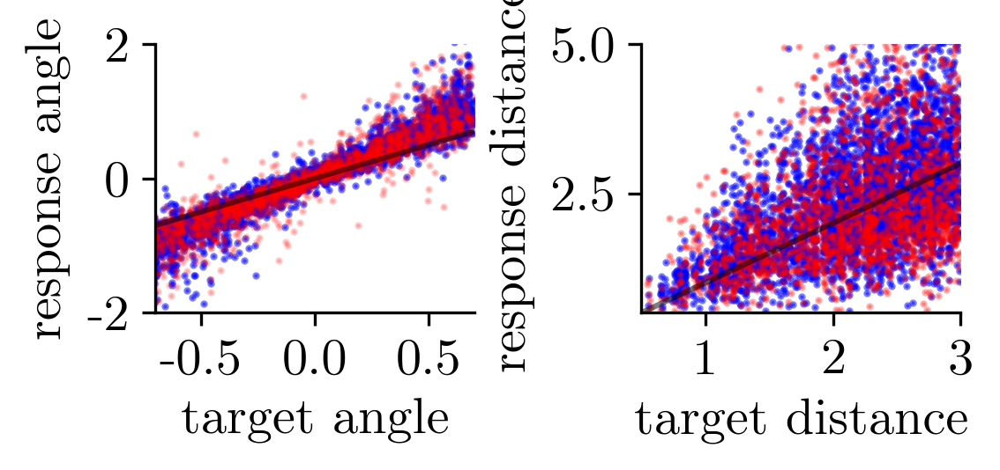

In [5]:
# behavioral small gain prior, and we confirmed it ------------------------
# load human without feedback data
datapath_=Path(datapath/"human/wohgroup")
with open(datapath_, 'rb') as f:
    hstates, hactions, htasks = pickle.load(f)

datapath_=Path(datapath/"human/woagroup")
with open(datapath_, 'rb') as f:
    astates, aactions, atasks = pickle.load(f)
# get the side tasks (stright trials do not have curvature)
res=[]
for task in htasks:
    d,a=xy2pol(task, rotation=False)
    # if  env.min_angle/2<=a<env.max_angle/2:
    if a<=-pi/5*0.7 or a>=pi/5*0.7:
        res.append(task)
sidetasks=np.array(res)

ares=np.array([s[-1].tolist() for s in astates])
# radial and angular distance response
ardist=np.linalg.norm(ares[:,:2],axis=1)
aadist=np.arctan2(ares[:,1],ares[:,0])
# radial and angular distance target
atasksda=np.array([xy2pol(t,rotation=False) for t in atasks])
artar=atasksda[:,0]
aatar=atasksda[:,1] # hatar=np.arctan2(htasks[:,1],htasks[:,0])
artarind=np.argsort(artar)
aatarind=sorted(aatar)

hres=np.array([s[-1].tolist() for s in hstates])
# radial and angular distance response
hrdist=np.linalg.norm(hres[:,:2],axis=1)
hadist=np.arctan2(hres[:,1],hres[:,0])
# radial and angular distance target
htasksda=np.array([xy2pol(t,rotation=False) for t in htasks])
hrtar=htasksda[:,0]
hatar=htasksda[:,1] # hatar=np.arctan2(htasks[:,1],htasks[:,0])
hrtarind=np.argsort(hrtar)
hatarind=sorted(hatar)

# plot the radial error and angular error
with initiate_plot(4,2,300) as f:
    ax=f.add_subplot(121)
    ax.scatter(hatar,hadist,s=1,alpha=0.5,color='b')
    ax.scatter(aatar,aadist,s=1,alpha=0.2,color='r')
    ax.set_xlim(-0.7,0.7)
    ax.set_ylim(-2,2)
    ax.plot([-1,1],[-1,1],'k',alpha=0.5)
    ax.set_xlabel('target angle')
    ax.set_ylabel('response angle')
    # ax.axis('equal')
    quickspine(ax)

    ax=f.add_subplot(122)
    ax.scatter(hrtar,hrdist,s=1,alpha=0.5,color='b')
    ax.scatter(artar,ardist,s=1,alpha=0.3,color='r')
    # ax.plot([.5,3],[.5,3],'k',alpha=0.5)
    ax.set_xlim(.5,3)
    ax.set_ylim(0.5,5)
    ax.plot([0,3],[0,3],'k',alpha=0.5)
    ax.set_xlabel('target distance')
    ax.set_ylabel('response distance')
    quickspine(ax)
    # ax.axis('equal')
    plt.tight_layout()

## per subject behavior

In [6]:

datapath_=Path(datapath/"human/hgroup")
with open(datapath_, 'rb') as f:
    hstates, hactions, htasks = pickle.load(f)

datapath_=Path(datapath/"human/agroup")
with open(datapath_, 'rb') as f:
    astates, aactions, atasks = pickle.load(f)

datapath_=Path(datapath/"human/wohgroup")
with open(datapath_, 'rb') as f:
    wohstates, wohactions, wohtasks = pickle.load(f)

datapath_=Path(datapath/"human/woagroup")
with open(datapath_, 'rb') as f:
    woastates, woaactions, woatasks = pickle.load(f)


filename=datapath/'human/fbsimple.mat'
data=loadmat(filename)

# seperate into two groups
hdata,adata=[],[]
for d in data:
    if d['name'][0]=='A':
        adata.append(d)
    else:
        hdata.append(d)
print('we have these number of health and autiusm subjects',len(hdata),len(adata))

hsublen=[len(eachsub['targ']['r']) for eachsub in hdata]
asublen=[len(eachsub['targ']['r']) for eachsub in adata]
hcumsum=np.cumsum(hsublen)
acumsum=np.cumsum(asublen)


# load inv data
numhsub,numasub=25,14
foldername='persub1cont'
logs={'a':datapath/'human/fixragroup','h':datapath/'human/clusterpaperhgroup'}

invres={'a':[],'h':[]}
for isub in range(numhsub):
    dataname="hsub{}".format(str(isub))
    savename=Path(datapath/"human/{}".format(foldername))/"invhsub{}".format(str(isub))
    if savename.is_file():
        invres['h'].append(process_inv(savename,ind=31, usingbest=True))
for isub in range(numasub):
    dataname="asub{}".format(str(isub))
    savename=Path(datapath/"human/{}".format(foldername))/"invasub{}".format(str(isub))
    if savename.is_file():
        invres['a'].append(process_inv(savename,ind=31, usingbest=True))




we have these number of health and autiusm subjects 25 14


In [7]:

# # plot overhead for each subject
# plot_overhead_for_each_subject=False
# if plot_overhead_for_each_subject:
#     for isub in range(len(hdata)):
#         s=0 if isub==0 else hcumsum[isub-1]
#         e=hcumsum[isub]
#         substates=hstates[s:e]
#         subtasks=htasks[s:e]
#         ax=quickoverhead_state(substates,subtasks)
#         print('infered theta: [\n', invres['h'][isub][0])

#     for isub in range(len(adata)):
#         s=0 if isub==0 else acumsum[isub-1]
#         e=acumsum[isub]
#         substates=astates[s:e]
#         subtasks=atasks[s:e]
#         ax=quickoverhead_state(substates,subtasks)
#         print('infered theta: [\n', invres['a'][isub][0])



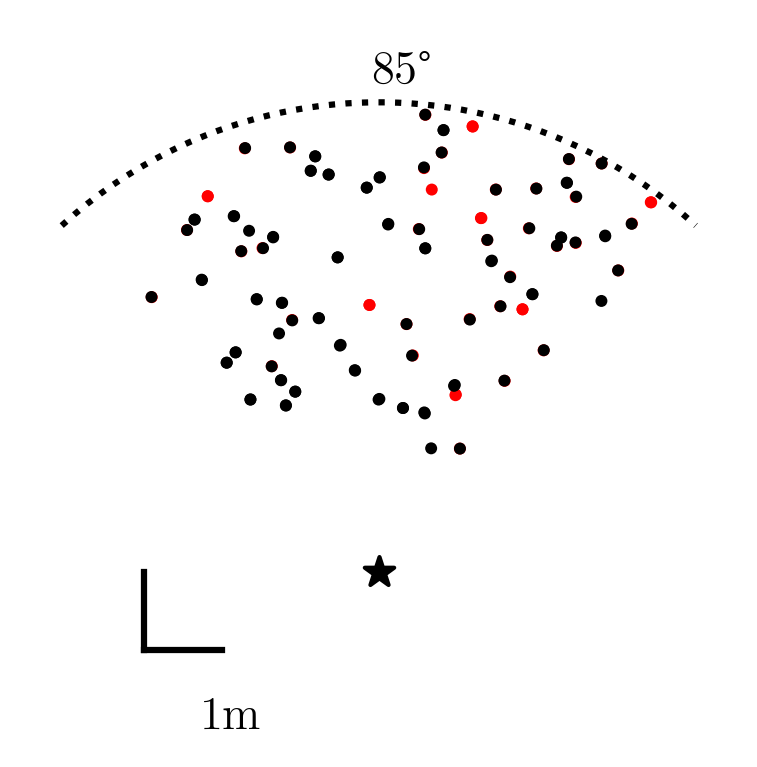

In [8]:
# example overhead plot ----------------------------------------
isub=4
s=0 if isub==0 else hcumsum[isub-1]
e=hcumsum[isub]
substates=hstates[s:e]
subtasks=htasks[s:e]
rewardedind=[1 if (sum((s[-1][:2]-t))**2)**0.5<(65/200) else 0 for s, t in zip(substates, subtasks)]
rewarded=[ i for i in range(len(rewardedind)) if rewardedind[i]]
sum(rewardedind)
unrewarded=[ i for i in range(len(rewardedind)) if not rewardedind[i]]
sum(rewardedind)
fontsize=11
alpha=1
with initiate_plot(3,3, 300) as fig:
    ax = fig.add_subplot(111)
    ax.set_aspect('equal')
    ax.axes.xaxis.set_ticks([]); ax.axes.yaxis.set_ticks([])
    # ax.set_xlim([-235, 235]); ax.set_ylim([-2, 430])
    xrange=np.cos(pi/180*(90-42.5))*600
    x_temp = np.linspace(-xrange, xrange)
    ax.plot(x_temp, np.sqrt(600**2 - x_temp**2), c='k', ls=':')
    ax.text(-10, 625, s=r'$85\degree$', fontsize=fontsize)

    ax.plot(np.linspace(-300, -200), np.linspace(-100, -100), c='k') # 100 is cm
    ax.plot(np.linspace(-300, -300), np.linspace(-100, 0), c='k')
    ax.text(-230, -200, s=r'$1 m$', fontsize=fontsize)

    ax.scatter(subtasks[unrewarded][:,1]*200,subtasks[unrewarded][:,0]*200, c='r',alpha=alpha, edgecolors='none',marker='.', s=33, lw=1,label='unrewarded')
    ax.scatter(subtasks[rewarded][:,1]*200,subtasks[rewarded][:,0]*200, c='k',alpha=alpha, edgecolors='none',marker='.', s=33, lw=1,label='rewarded')

    ax.scatter(0,0, marker='*', color='black', s=55) 

    ax.axis('equal')
    # quickleg(ax)
    quickallspine(ax)
    quicksave('example all trial overhead targets')


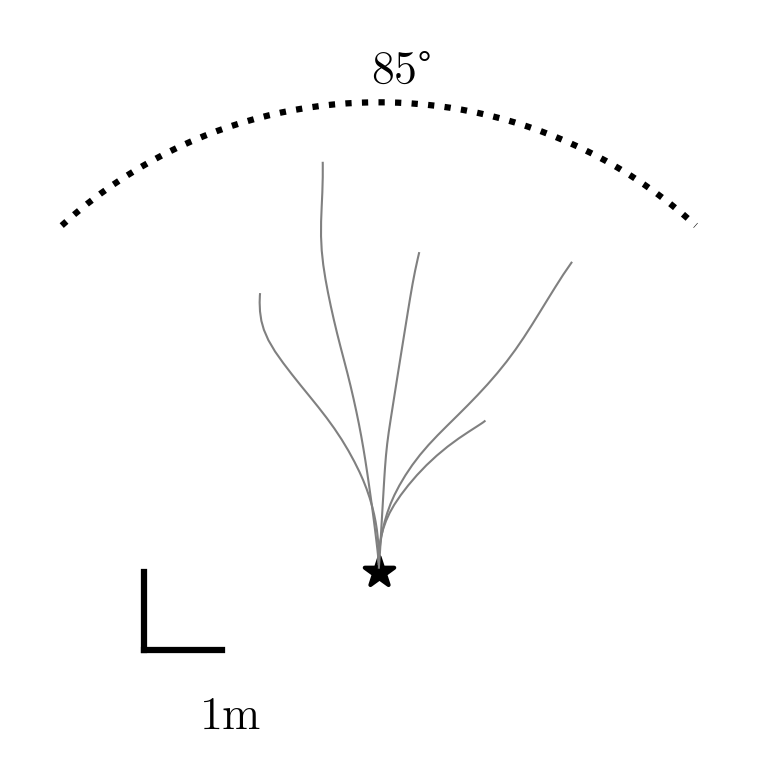

In [9]:
# example overhead trajectory plot ----------------------------------------
isub=4
s=0 if isub==0 else hcumsum[isub-1]
e=hcumsum[isub]
substates=hstates[s:e]
subtasks=htasks[s:e]
rewardedind=[1 if (sum((s[-1][:2]-t))**2)**0.5<(65/200) else 0 for s, t in zip(substates, subtasks)]
rewarded=[ i for i in range(len(rewardedind)) if rewardedind[i]]
sum(rewardedind)
unrewarded=[ i for i in range(len(rewardedind)) if not rewardedind[i]]
sum(rewardedind)
fontsize=11
alpha=1
with initiate_plot(3,3, 300) as fig:
    ax = fig.add_subplot(111)
    ax.set_aspect('equal')
    ax.axes.xaxis.set_ticks([]); ax.axes.yaxis.set_ticks([])
    # ax.set_xlim([-235, 235]); ax.set_ylim([-2, 430])
    xrange=np.cos(pi/180*(90-42.5))*600
    x_temp = np.linspace(-xrange, xrange)
    ax.plot(x_temp, np.sqrt(600**2 - x_temp**2), c='k', ls=':')
    ax.text(-10, 625, s=r'$85\degree$', fontsize=fontsize)

    ax.plot(np.linspace(-300, -200), np.linspace(-100, -100), c='k') # 100 is cm
    ax.plot(np.linspace(-300, -300), np.linspace(-100, 0), c='k')
    ax.text(-230, -200, s=r'$1 m$', fontsize=fontsize)

    for s in substates[:5]:
        ax.plot(s[:,1]*200,s[:,0]*200, c='grey',alpha=alpha, linewidth=0.5)
    # ax.scatter(subtasks[:5][:,1]*200,subtasks[:5][:,0]*200)


    ax.scatter(0,0, marker='*', color='black', s=55) 

    ax.axis('equal')
    # quickleg(ax)
    quickallspine(ax)
    # quicksave('example all trial overhead trajectgory')



In [10]:
# overhead of one particular trial -------------------------------------
plot_example_overhead_each_subject=False
if plot_example_overhead_each_subject:
    isub=0
    s=0 if isub==0 else acumsum[isub-1]
    e=acumsum[isub]
    substates=astates[s:e]
    subtasks=atasks[s:e]
    # selections
    selctinds=similar_trials2this(subtasks, [1.8,1.3],ntrial=2)
    a=subtasks[selctinds]
    b=[substates[i] for i in selctinds]
    # plt.scatter(a[:,0]*200,a[:,1]*200)
    # plt.axis('equal')
    fig, ax = plt.subplots()
    ax=quickoverhead_state(b,a,ax=ax,goalcircle=True)
    # ax.add_patch(plt.Circle((a[0,0],a[0,1]), 0.13, color='y', alpha=0.5))
    ax.set_title(invres['a'][isub][0][1].item())
    ax.set_xticklabels(np.array(ax.get_xticks()).astype('int')*200)
    ax.set_yticklabels(np.array(ax.get_xticks()).astype('int')*200)
    isub+=1
    # quicksave('asd subject {} example path'.format(isub),fig=fig)

    isub=0
    s=0 if isub==0 else hcumsum[isub-1]
    e=hcumsum[isub]
    substates=hstates[s:e]
    subtasks=htasks[s:e]
    # selections
    selctinds=similar_trials2this(subtasks, [1.8,1.3],ntrial=2)
    a=subtasks[selctinds]
    b=[substates[i] for i in selctinds]
    # plt.scatter(a[:,0]*200,a[:,1]*200)
    # plt.axis('equal')
    fig, ax = plt.subplots()
    ax=quickoverhead_state(b,a,ax=ax,goalcircle=True)
    # ax.add_patch(plt.Circle((a[0,0],a[0,1]), 0.13, color='y', alpha=0.5))
    ax.set_title(invres['h'][isub][0][1].item())
    ax.set_xticklabels(np.array(ax.get_xticks()).astype('int')*200)
    ax.set_yticklabels(np.array(ax.get_xticks()).astype('int')*200)
    isub+=1
    # quicksave('control subject {} example path'.format(isub),fig=fig)


In [11]:
# feedback vs no feedback overhead -------------------------------
plot_feedback_example_overhead_each_subject=False
if plot_feedback_example_overhead_each_subject:
    fig, ax = plt.subplots()
    selctinds=similar_trials2this(htasks, [1.8,1.3],ntrial=2)
    a=htasks[selctinds] # tasks
    b=[hstates[i] for i in selctinds] # states
    ax=quickoverhead_state(b,a,ax=ax,goalcircle=True)
    ax.get_figure()

    fig, ax = plt.subplots()
    selctinds=similar_trials2this(wohtasks, [1.8,1.3],ntrial=2)
    a=wohtasks[selctinds] # tasks
    b=[wohstates[i] for i in selctinds] # states
    ax=quickoverhead_state(b,a,ax=ax,goalcircle=True)
    ax.get_figure()

    ax.set_title(invres['a'][isub][0][1].item())
    ax.set_xticklabels(np.array(ax.get_xticks()).astype('int')*200)
    ax.set_yticklabels(np.array(ax.get_xticks()).astype('int')*200)

    quickoverhead_state(hstates[100:200],htasks[100:200])
    quickoverhead_state(wohstates[100:200],wohtasks[100:200])

    quickoverhead_state(astates[100:200],atasks[100:200])
    quickoverhead_state(woastates[100:200],woatasks[100:200])


## inferred params

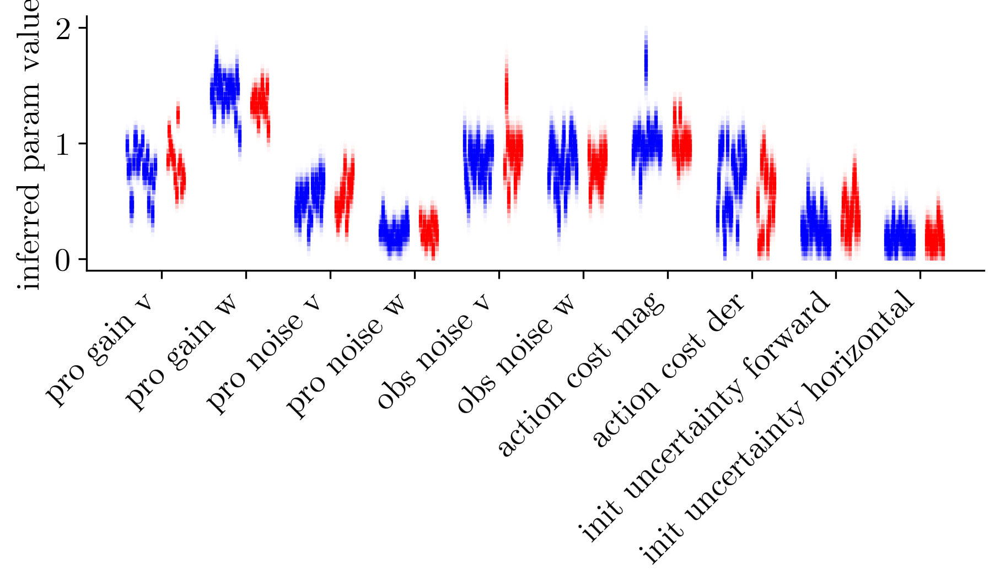

In [62]:
# together figure

theta_names = [ r'pro gain $v$',
                r'pro gain $w$',
                r'pro noise $v$',
                r'pro noise $w$',
                r'obs noise $v$',
                r'obs noise $w$',
                'action cost mag',      
                'action cost der',      
                'init uncertainty forward',      
                'init uncertainty horizontal',      
                ]

subshift=0.015
with initiate_plot(7,2,300) as fig:
    ax=fig.add_subplot(111)
    quickspine(ax)
    ax.set_xticks(list(range(10)))
    ax.set_xticklabels(theta_names, rotation=45, ha='right')
    ax.set_ylabel('inferred param value')
    colory=np.linspace(0,2,50) # the verticle range of most parameters
    colory=torch.linspace(0,2,50) # the verticle range of most parameters
    for ithsub, log in enumerate(invres['h']): # each control subject
        for i, mu in enumerate(log[0]): # each parameter
            std=(torch.diag(log[1])**0.5)[i]*0.1
            prob=lambda y: torch.exp(-0.5*(y-mu)**2/std**2)
            proby=prob(colory)
            for j in range(len(colory)-1):
                c=proby[j].item()
                plt.plot([i-(ithsub+5)*subshift,i-(ithsub+5)*subshift],[colory[j],colory[j+1]],c=[0,0,1], alpha=c)
    for ithsub, log in enumerate(invres['a']): # each asd subject
        for i, mu in enumerate(log[0]): # each parameter
            std=(torch.diag(log[1])**0.5)[i]*0.1
            prob=lambda y: torch.exp(-0.5*(y-mu)**2/std**2)
            proby=prob(colory)
            for j in range(len(colory)-1):
                c=proby[j].item()
                plt.plot([i+(ithsub+5)*subshift,i+(ithsub+5)*subshift],[colory[j],colory[j+1]],c=[1,0,0], alpha=c)
    # quicksave('human per sub pixel line new')


In [13]:
# # v style
# with initiate_plot(7,4,300) as fig:
#     ax=fig.add_subplot(211)
#     quickspine(ax)
#     ax.set_xticks(np.linspace(0,10,6))
#     ax.set_xticklabels([theta_names[i] for i in [0,2,4,6,8,8]], rotation=45, ha='right')
#     ax.set_ylabel('inferred params')
#     for i in np.arange(0,10,2):
#         plt.plot([i-0.5,i+0.5],[2.05,2.05], color='k')
#     # ax.set_ylim(None, 2.1)
#     ax.set_yticks([])
#     colory=np.linspace(0,2,50) # the verticle range of most parameters
#     colory=torch.linspace(0,2,50) # the verticle range of most parameters
#     for ithsub, log in enumerate(invres['h']): # each control subject
#         for i, mu in enumerate(log[0]): # each parameter
#             if i in [0,2,4,6,8]:
#                 std=(torch.diag(log[1])**0.5)[i]*0.1
#                 prob=lambda y: torch.exp(-0.5*(y-mu)**2/std**2)
#                 proby=prob(colory)
#                 for j in range(len(colory)-1):
#                     c=proby[j].item()
#                     plt.plot([i-(ithsub)*1/numhsub,i-(ithsub)*1/numhsub],[colory[j],colory[j+1]],c=[1-c,1-c,1])

#     for ithsub, log in enumerate(invres['a']): # each asd subject
#         for i, mu in enumerate(log[0]): # each parameter
#             if i in [0,2,4,6,8]:
#                 std=(torch.diag(log[1])**0.5)[i]*0.1
#                 proby=prob(colory)
#                 for j in range(len(colory)-1):
#                     c=proby[j].item()
#                     plt.plot([i+(ithsub)*1/numhsub,i+(ithsub)*1/numhsub],[colory[j],colory[j+1]],c=[1,1-c,1-c])
#     # quicksave('forward theta together')

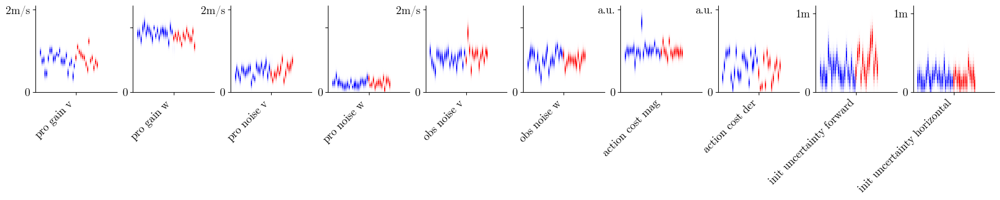

In [63]:
# individual style
with initiate_plot(22,2,100) as fig:
    for i in range(len(theta_names)):
        ax=fig.add_subplot(1,10,1+i)
        quickspine(ax)
        ax.set_xticks([0])
        ax.set_xticklabels([theta_names[i]], rotation=45, ha='right')
        
        # ax.set_ylabel('inferred parameter')
        ax.set_ylim(0, 2.1)
        ax.set_xlim(-1,1)
        ax.set_yticks([0,2])

        if i in [0,2,4]:
            ax.set_yticklabels([0,'2m/s'])
        elif i in [1,3,5]:
            ax.set_yticklabels([0,'90 degree/s'])
            ax.set_yticks([0,pi/2])
            ax.set_ylim(0, 2.1)
        elif i in [6,7]:
            ax.set_yticklabels([0,'a.u.'])  
        elif i in [8,9]:
            ax.set_ylim(0, 1.1)
            ax.set_yticks([0,1])
            ax.set_yticklabels([0,'1m'])  
        # colory=np.linspace(0,2,50) 
        colory=torch.linspace(0,2,50) 
        for ithsub, log in enumerate(invres['h']): # each control subject
            mu=log[0][i]
            std=(torch.diag(log[1])**0.5)[i]*0.1
            prob=lambda y: torch.exp(-0.5*(y-mu)**2/std**2)
            proby=prob(colory)
            for j in range(len(colory)-1):
                c=proby[j].item()
                ax.plot([-(ithsub)*1/numhsub,-(ithsub)*1/numhsub],[colory[j],colory[j+1]],c=[1-c,1-c,1])
        for ithsub, log in enumerate(invres['a']): # each asd subject
            mu=log[0][i]
           
            std=(torch.diag(log[1])**0.5)[i]*0.1
            proby=prob(colory)
            for j in range(len(colory)-1):
                c=proby[j].item()
                ax.plot([(ithsub)*1/numhsub,(ithsub)*1/numhsub],[colory[j],colory[j+1]],c=[1,1-c,1-c])
    plt.tight_layout()
    # quicksave('theta together v2')


In [15]:
# # t test plots

# # connected line with error bar style
# x=np.array(list(range(10)))
# hy=np.array([np.array(log[0].view(-1)) for log in invres['h']])
# ay=np.array([np.array(log[0].view(-1)) for log in invres['a']])
# plt.errorbar(x, np.mean(hy,axis=0), np.std(hy,axis=0))
# plt.errorbar(x+0.3, np.mean(ay,axis=0), np.std(ay,axis=0))


# # biased degree v
# ''' bias*(p/p+o) '''
# biash=(pi/2-hy[:,0])/(pi/2) * (hy[:,2]/(hy[:,2]+hy[:,4]))
# biasa=(pi/2-ay[:,0])/(pi/2) * (ay[:,2]/(ay[:,2]+ay[:,4]))
# plt.figure(figsize=(1,3))
# plt.scatter([0]*len(biash), biash,alpha=0.1)
# plt.scatter([1]*len(biasa), biasa,alpha=0.1)


# # biased degree w
# biash=(pi/2-hy[:,1])/(pi/2) * (hy[:,3]/(hy[:,3]+hy[:,5]))
# biasa=(pi/2-ay[:,1])/(pi/2) * (ay[:,3]/(ay[:,3]+ay[:,5]))
# plt.figure(figsize=(1,3))
# plt.scatter([0]*len(biash), biash,alpha=0.1)
# plt.scatter([1]*len(biasa), biasa,alpha=0.1)


# # cost w
# plt.figure(figsize=(1,3))
# plt.scatter([0]*len(biash), hy[:,7],alpha=0.3)
# plt.scatter([1]*len(biasa), ay[:,7],alpha=0.3)


# # t test each papram (asd vs nt)
# theta_sclar=[2,180/pi,2,180/pi,2,180/pi,1,1,2,2]
# for i in range(len(theta_names)):
#     print(theta_names[i],'\n',stats.ttest_ind(hy[:,i],ay[:,i]))
#     print('summary, asd \n', npsummary(ay[:,i]*theta_sclar[i]))
#     print('summary, nt \n', npsummary(hy[:,i]*theta_sclar[i]))

# # t test each gain (asd or vs true task)
# print(theta_names[0],'\n',stats.ttest_1samp(hy[:,0], 1,alternative='less'))
# print(theta_names[0],'\n',stats.ttest_1samp(ay[:,0], 1,alternative='less'))
# print(theta_names[1],'\n',stats.ttest_1samp(hy[:,1], pi/2,alternative='less'))
# print(theta_names[1],'\n',stats.ttest_1samp(ay[:,1], pi/2,alternative='less'))

# stats.ttest_ind(biash,biasa)
# npsummary(biash)
# npsummary(biasa)


param: pro gain $v$
        NTmean:0.75, NT SEM:0.00,
        ASDmean:0.82, NT SEM:0.00
param: pro gain $w$
        NTmean:1.42, NT SEM:0.00,
        ASDmean:1.32, NT SEM:0.00
param: pro noise $v$
        NTmean:0.50, NT SEM:0.00,
        ASDmean:0.51, NT SEM:0.00
param: pro noise $w$
        NTmean:0.20, NT SEM:0.00,
        ASDmean:0.22, NT SEM:0.00
param: obs noise $v$
        NTmean:0.80, NT SEM:0.00,
        ASDmean:0.89, NT SEM:0.00
param: obs noise $w$
        NTmean:0.80, NT SEM:0.00,
        ASDmean:0.76, NT SEM:0.00
param: action cost mag
        NTmean:1.01, NT SEM:0.00,
        ASDmean:0.98, NT SEM:0.00
param: action cost der
        NTmean:0.65, NT SEM:0.01,
        ASDmean:0.49, NT SEM:0.01
param: init uncertainty forward
        NTmean:0.25, NT SEM:0.00,
        ASDmean:0.38, NT SEM:0.00
param: init uncertainty horizontal
        NTmean:0.17, NT SEM:0.00,
        ASDmean:0.17, NT SEM:0.00


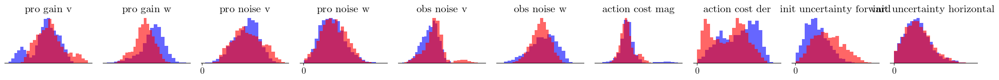

In [71]:
# groupd distribution

# inferred theta svm --------------------------
# load inv data
numhsub,numasub=25,14
foldername='persub1cont'
logs={'a':datapath/'human/fixragroup','h':datapath/'human/clusterpaperhgroup'}

invres={'a':[],'h':[]}
for isub in range(numhsub):
    dataname="hsub{}".format(str(isub))
    savename=Path(datapath/"human/{}".format(foldername))/"invhsub{}".format(str(isub))
    if savename.is_file():
        invres['h'].append(process_inv(savename,ind=31, usingbest=True))
for isub in range(numasub):
    dataname="asub{}".format(str(isub))
    savename=Path(datapath/"human/{}".format(foldername))/"invasub{}".format(str(isub))
    if savename.is_file():
        invres['a'].append(process_inv(savename,ind=31, usingbest=True))

numsamples=100
adjustratio=len(invres['h'])/len(invres['a'])
alltag=[]
allsamples=[]
for theta,cov,_ in invres['a']:
    distribution=MultivariateNormal(theta.view(-1),cov*0.01)
    samples=[]
    while len(samples)<int(numsamples*adjustratio):
        a=distribution.sample()
        if torch.all(a.clamp(0,2)==a):
            samples.append(a)
    allsamples.append(torch.stack(samples))
    alltag+=[1]*int(numsamples*adjustratio)
for theta,cov,_ in invres['h']:
    distribution=MultivariateNormal(theta.view(-1),cov*0.01)
    samples=[]
    while len(samples)<numsamples:
        a=distribution.sample()
        if torch.all(a.clamp(0,2)==a):
            samples.append(a)
    allsamples.append(torch.stack(samples))
    alltag+=[0]*numsamples

allsamples=np.array(torch.cat(allsamples,axis=0))
alltag=np.array(alltag).astype('int')

# distributions
with initiate_plot(22,2,100) as fig:
    for i in range(len(theta_names)):
        ax=fig.add_subplot(1,10,1+i)
        quickspine(ax)
        ax.set_xticks([0])
        ax.set_title(theta_names[i])
        ax.spines['left'].set_visible(False)
        ax.yaxis.set_ticks([])
        ax.yaxis.set_ticklabels([])
        
        thisdata=allsamples[alltag==0]
        _=ax.hist(allsamples[alltag==0][:,i],density=True, bins=22,color='b',alpha=0.6)
        _=ax.hist(allsamples[alltag==1][:,i],density=True, bins=22,color='r',alpha=0.6)

    plt.tight_layout()
    quicksave('theta group together')


In [80]:
# stats
scaled_allsamples=allsamples.copy()
scaled_allsamples[:,[0,2,4,8,9]]=scaled_allsamples[:,[0,2,4,8,9]]*200
scaled_allsamples[:,[1,3,5]]=scaled_allsamples[:,[1,3,5]]*180/pi
for i in range(len(theta_names)):
    print(f'param: {theta_names[i]}\n\
        NTmean:{np.mean(scaled_allsamples[alltag==0][:,i]):.2f}, NT SEM:{scipy.stats.sem(scaled_allsamples[alltag==0][:,i]):.2f},\n\
        ASDmean:{np.mean(scaled_allsamples[alltag==1][:,i]):.2f}, NT SEM:{scipy.stats.sem(scaled_allsamples[alltag==1][:,i]):.2f}') 


param: pro gain $v$
        NTmean:150.69, NT SEM:0.78,
        ASDmean:163.65, NT SEM:0.78
param: pro gain $w$
        NTmean:81.22, NT SEM:0.17,
        ASDmean:75.53, NT SEM:0.14
param: pro noise $v$
        NTmean:99.68, NT SEM:0.58,
        ASDmean:102.55, NT SEM:0.68
param: pro noise $w$
        NTmean:11.73, NT SEM:0.11,
        ASDmean:12.37, NT SEM:0.11
param: obs noise $v$
        NTmean:160.59, NT SEM:0.64,
        ASDmean:178.54, NT SEM:0.89
param: obs noise $w$
        NTmean:45.73, NT SEM:0.24,
        ASDmean:43.62, NT SEM:0.16
param: action cost mag
        NTmean:1.01, NT SEM:0.00,
        ASDmean:0.98, NT SEM:0.00
param: action cost der
        NTmean:0.65, NT SEM:0.01,
        ASDmean:0.49, NT SEM:0.01
param: init uncertainty forward
        NTmean:49.14, NT SEM:0.53,
        ASDmean:75.87, NT SEM:0.71
param: init uncertainty horizontal
        NTmean:33.26, NT SEM:0.38,
        ASDmean:34.44, NT SEM:0.39


## vary param experiment

In [65]:
# vary params, see behavior influence --------------------------------------
print('''
sliding along parameter axis and show this affects path curvature. 
show the likelihood of each location.
''')

# load agent and task
env=ffacc_real.FireFlyPaper(arg)
env.episode_len=50
env.debug=1
env.terminal_vel=0.2
phi=torch.tensor([[1],
            [pi/2],
            [0.001],
            [0.001],
            [0.001],
            [0.001],
            [0.13],
            [0.001],
            [0.001],
            [0.001],
            [0.001],
    ])
agent_=TD3.load('trained_agent/paper.zip')
agent=agent_.actor.mu.cpu()

# define the midpoint between ASD and healthy 
logls=[datapath/'human/fixragroup',datapath/'human/clusterpaperhgroup']
monkeynames=['ASD', 'Ctrl' ]

mus,covs,errs=[],[],[]
thetas=[]
for inv in logls:
    finaltheta,finalcov, err=process_inv(inv,ind=60,removegr=False)
    mus.append(np.array(finaltheta).reshape(-1))
    covs.append(finalcov)
    errs.append(err)
    thetas.append(finaltheta)
thetas=torch.tensor(mus)
theta_init=thetas[0]
theta_final=thetas[1]

# load theta distributions and compute svm
alltag=[]
alltheta=[]
loglls=[]
with open(logls[0],'rb') as f:
    log=pickle.load(f)
    res=[l[2] for l in log[19:99]]
    for r in res:
        for point in r:
            alltheta.append(point[0]) # theta
            loglls.append(point[1])
            alltag.append(0)
with open(logls[1],'rb') as f:
    log=pickle.load(f)
    res=[l[2] for l in log[19:99]]
    for r in res:
        for point in r:
            alltheta.append(point[0]) # theta
            loglls.append(point[1])
            alltag.append(1)

alltheta=np.array(alltheta)
alltag=np.array(alltag)

clf = svm.SVC(kernel="linear", C=1000)
clf.fit(alltheta, alltag)
w = clf.coef_[0] # the normal vector
midpoint=(mus[0]+mus[1])/2
lb=np.array([0,0,0,0,0,0,0.129,0,0,0,0])
hb=np.array([1,2,1,1,1,1,0.131,2,2,1,1])



sliding along parameter axis and show this affects path curvature. 
show the likelihood of each location.



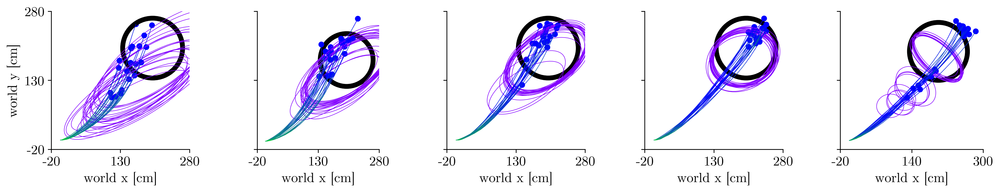

In [17]:

# vary from asd to health (along the svm normal vector)
theta_init=np.min(midpoint-lb)/w[np.argmin(hb-midpoint)]*-w*10+midpoint
theta_final=np.min(midpoint-lb)/w[np.argmin(midpoint-lb)]*w*10+midpoint
theta_init,theta_final=torch.tensor(theta_init).view(-1,1).float(),torch.tensor(theta_final).view(-1,1).float()
vary_theta_new(agent, env, phi, theta_init, theta_final,5,etask=[1,1], ntrials=20,savename='vary asd axis')


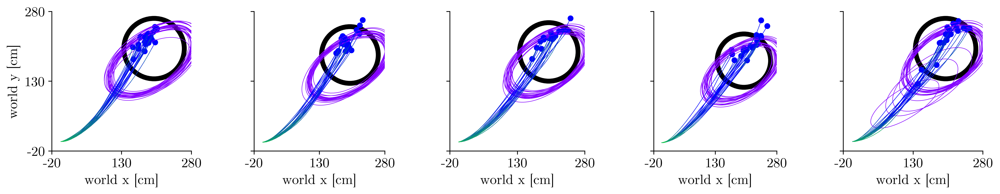

In [18]:

# vary from asd to health (along the svm normal vector)
theta_init=mus[0]
theta_final=mus[1]
theta_init,theta_final=torch.tensor(theta_init).view(-1,1).float(),torch.tensor(theta_final).view(-1,1).float()
vary_theta_new(agent, env, phi, theta_init, theta_final,5,etask=[1,1], ntrials=20,savename='vary asd axis actual range')


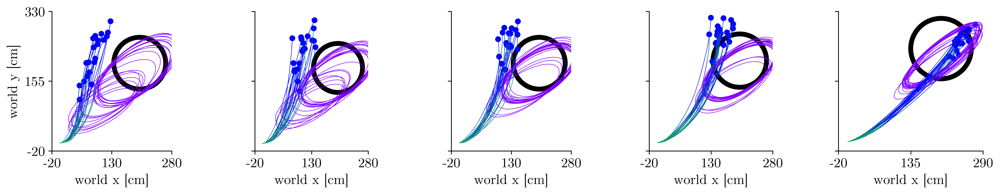

In [19]:

# vary obs noise (x axis in delta plot)
theta_init=midpoint.copy();theta_final=midpoint.copy()
theta_init[1]=1
theta_final[1]=1
theta_init[5]=2
theta_final[5]=0
theta_init,theta_final=torch.tensor(theta_init).view(-1,1).float(),torch.tensor(theta_final).view(-1,1).float()
vary_theta_new(agent, env, phi, theta_init, theta_final,5,etask=[1,1], ntrials=20,savename='vary trust obs axis')


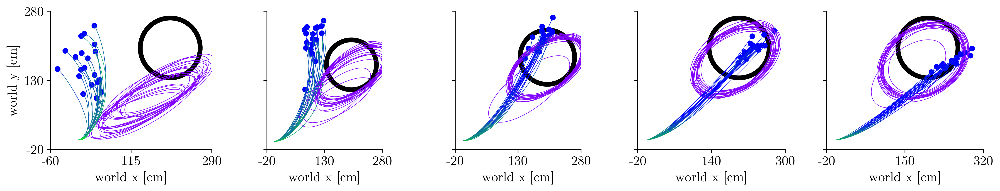

In [20]:
# vary small gain to correct
theta_init=midpoint.copy();theta_final=midpoint.copy()
theta_init[1]=0.5
theta_final[1]=2
theta_init,theta_final=torch.tensor(theta_init).view(-1,1).float(),torch.tensor(theta_final).view(-1,1).float()
vary_theta_new(agent, env, phi, theta_init, theta_final,5,etask=[1,1], ntrials=20,savename='vary assumed gain')
# quicksave('0 wgain to 2')


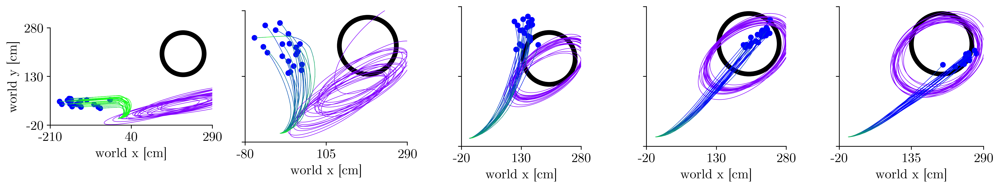

In [21]:
# vary bias (y axis in delta plot)
theta_init=midpoint.copy();theta_final=midpoint.copy()
theta_init[1]=0
theta_final[1]=2
theta_init,theta_final=torch.tensor(theta_init).view(-1,1).float(),torch.tensor(theta_final).view(-1,1).float()
vary_theta_new(agent, env, phi, theta_init, theta_final,5,etask=[1,1], ntrials=20)


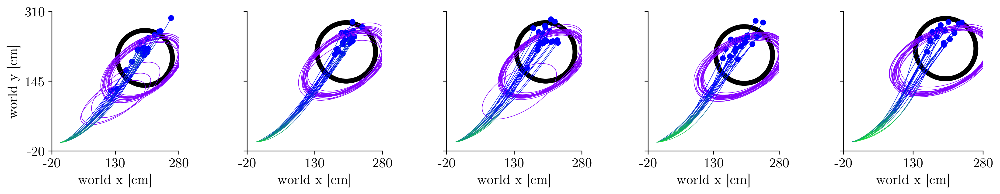

In [22]:

# vary x(forward) uncertainty (y axis in delta plot)
theta_init=midpoint.copy();theta_final=midpoint.copy()
theta_init[-2]=0
theta_final[-2]=2
theta_init,theta_final=torch.tensor(theta_init).view(-1,1).float(),torch.tensor(theta_final).view(-1,1).float()
vary_theta_new(agent, env, phi, theta_init, theta_final,5,etask=[1,1], ntrials=20)


## joint likelihood

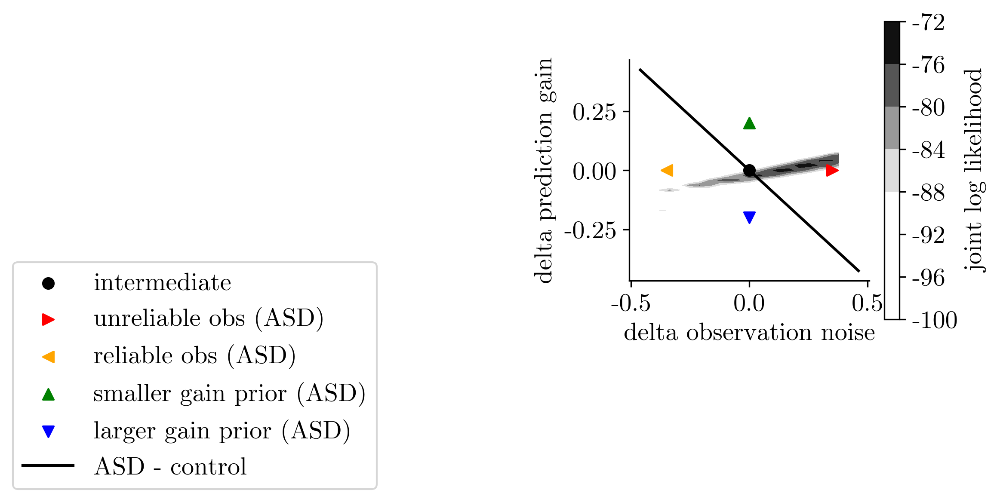

In [23]:
# the delta logll -------------------------------
gridreso=11
def totalbias(g,p,o):
    return g*(p**2/(p**2+o**2))
def totalgivenop(a,b):
    return (a**2)*(b**2)/((a**2)+(b**2))
def pogiventotal(a, c):
    return ((a**2)*c/((a**2)-c))**0.5
dx,dy=np.zeros((11)),np.zeros((11))
dx[5]=1
dy[3]=1

auncertainty=mus[0][5]**2*mus[0][3]**2/(mus[0][5]**2+mus[0][3]**2)
huncertainty=(mus[1][5]**2*mus[1][3]**2)/(mus[1][5]**2+mus[1][3]**2)
abias=totalbias(mus[0][1],mus[0][3],mus[0][5])
hbias=totalbias(mus[1][1],mus[1][3],mus[1][5])

c=totalgivenop(mus[0][5],mus[0][3])
pogiventotal(mus[0][5],auncertainty)

X,Y=np.linspace(-0.4,0.4,gridreso),np.linspace(-0.2,0.2,gridreso) # on and pn
paramls=[]
z=np.zeros((gridreso,gridreso))
for i in range(gridreso):
    for j in range(gridreso):
        # vary process noise and obs noise.
        # calcualte the gains while keep bias same
        anewparam_=torch.tensor(-dx*X[i]-dy*Y[j]+midpoint).float().view(-1,1)
        hnewparam_=torch.tensor(dx*X[i]+dy*Y[j]+midpoint).float().view(-1,1)

        anewpnoise=anewparam_[3]
        anewk = anewpnoise**2 / (anewparam_[5]**2+anewpnoise**2)
        anewg=abias/anewk
        anewparam_[1]=anewg


        hnewpnoise=hnewparam_[3]
        hnewk = hnewpnoise**2 / (hnewparam_[5]**2+hnewpnoise**2)
        hnewg=hbias/hnewk
        hnewparam_[1]=hnewg

        atheta=anewparam_.clone()
        htheta=hnewparam_.clone()
        paramls.append([atheta,htheta])
        z[i,j]=(atheta-htheta)[5]


with open(datapath/'human/distinguishparamZtwonoisessmaller2finer19', 'rb') as f:
    paramls,Z= pickle.load(f)
formatedZ=np.array(Z).reshape(int(len(Z)**0.5),int(len(Z)**0.5)).T
truedelta=mus[1]-mus[0]

with initiate_plot(3,3,300) as f:
    ax=f.add_subplot(111)
    # im=ax.imshow(formatedZ,origin='lower', extent=(X[0],X[-1],Y[0],Y[-1]),aspect='auto',vmin=-88, vmax=-73)
    # im=ax.imshow(formatedZ[:-1,:],origin='lower', extent=(X[0],X[-2],Y[0],Y[-1]),aspect='auto',vmin=-103, vmax=-73)
    formatedZ=np.clip(formatedZ[::-1,::-1],-99,0)
    im=ax.contourf(formatedZ,origin='lower', extent=(X[0],X[-1],Y[0],Y[-1]),vmin=-88, vmax=-73,cmap='binary')
    ax.set_aspect('equal')
    plt.colorbar(im,label='joint log likelihood') 
    ax.scatter(0,0,label='intermediate',color='k') # midpoint, 0,0
    ax.scatter(max(X)-0.05,0,label='unreliable obs (ASD)',color='r',marker='>') 
    ax.scatter(min(X)+0.05,0,label='reliable obs (ASD)',color='orange',marker='<') 
    ax.scatter(0, 0.2,label='smaller gain prior (ASD)',color='g',marker='^') 
    ax.scatter(0, -0.2,label='larger gain prior (ASD)',color='b',marker='v') 
    dx,dy=0.05*w[1],0.05*w[5]
    ax.plot([-dx,dx],[-dy,dy],label='ASD - control',color='k',) 
    ax.set_xlabel('delta observation noise')
    ax.set_ylabel('delta prediction gain')
    # ax.scatter(truedelta[5]/2,truedelta[3]/2,label='inferred delta') # inferred delta
    quickleg(ax)
    quickspine(ax)

    quicksave('gray logll obs prediction vs obs with label')



## eigvector heatmap

In [24]:
# load data 
asd_data_set={}
numhsub,numasub=25,14
fulltrainfolder='persub1cont'
parttrainfolder='persub3of5dp'
for invtag in ['h','a']:
    for isub in range(numhsub):
        thesub="{}sub{}".format(invtag,str(isub))
        evalname=Path(datapath/"human/{}/evaltrain_inv{}sub{}".format(parttrainfolder,invtag,str(isub)))
        fullinverseres=Path(datapath/"human/{}".format(fulltrainfolder))/"inv{}sub{}".format(invtag,str(isub))
        partinverseres=Path(datapath/"human/{}".format(parttrainfolder))/"inv{}sub{}".format(invtag,str(isub))
        # load inv res
        if fullinverseres.is_file():
            asd_data_set['res'+thesub]=process_inv(fullinverseres, usingbest=True, removegr=True)
        # load data
        if Path(datapath/'human/{}'.format(thesub)).is_file():
            with open(datapath/'human/{}'.format(thesub), 'rb') as f:
                states, actions, tasks = pickle.load(f)
            # print(len(states))
            asd_data_set['data'+thesub]=states, actions, tasks


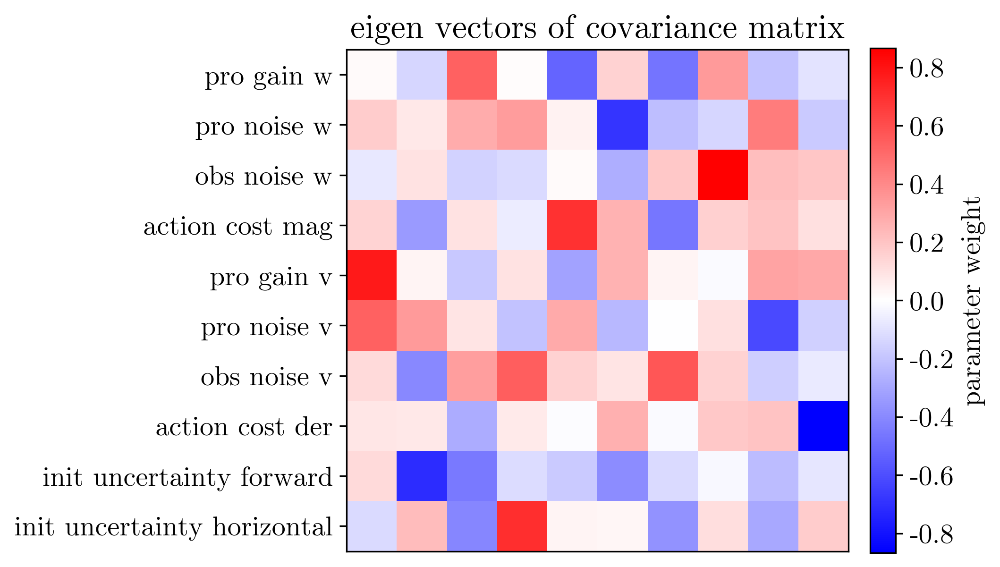

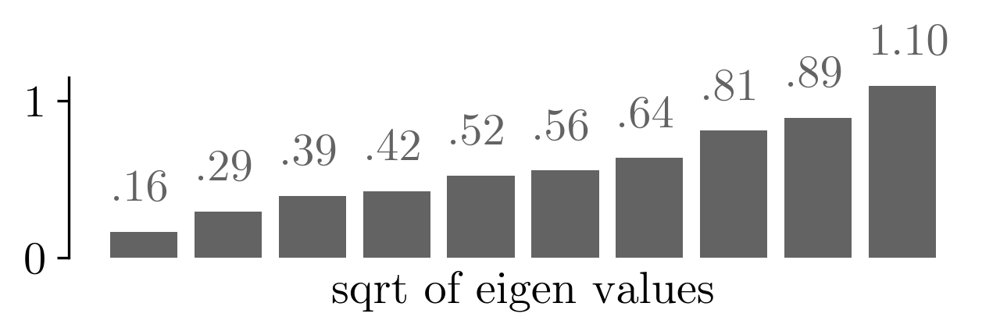

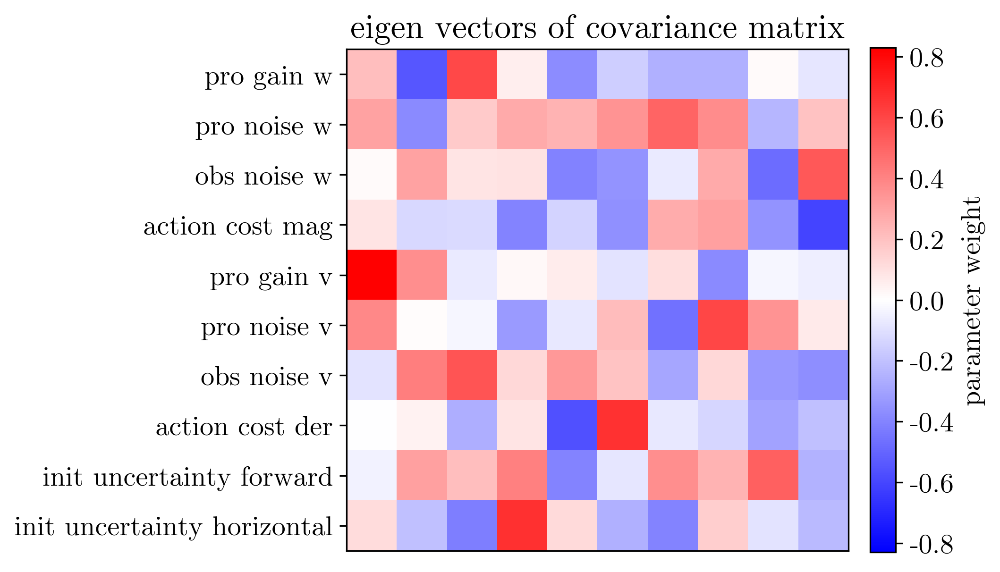

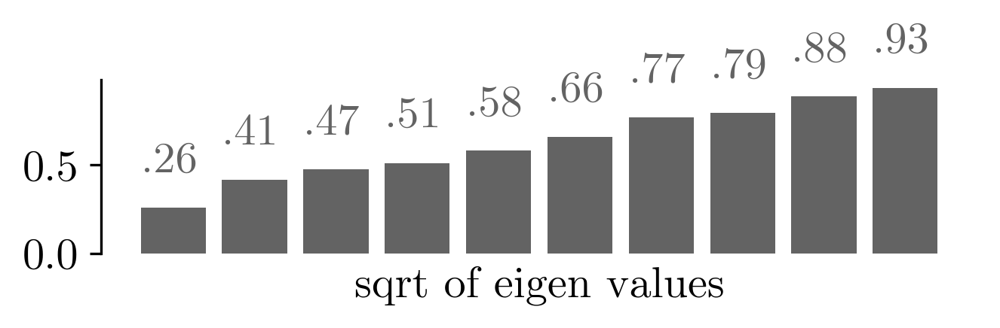

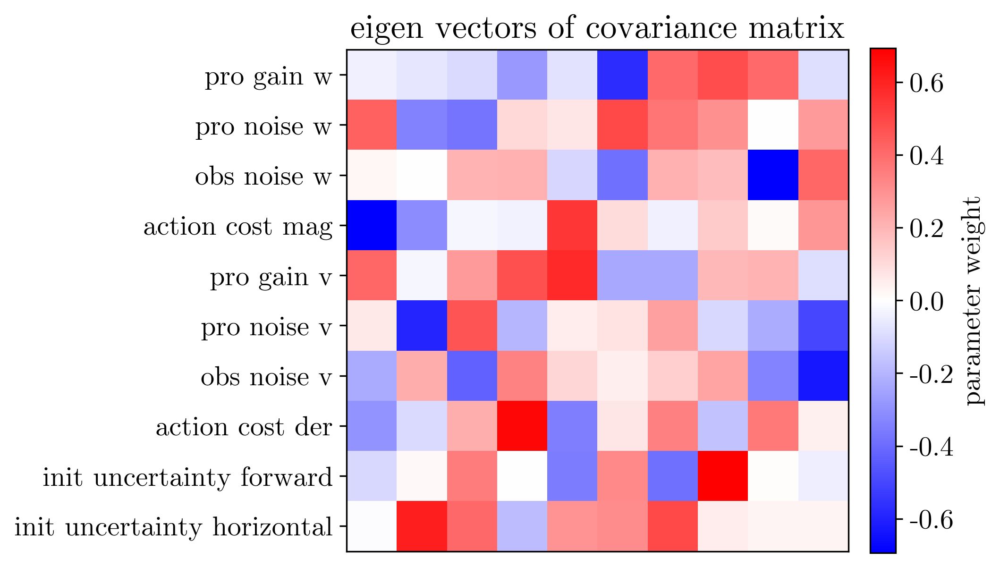

...

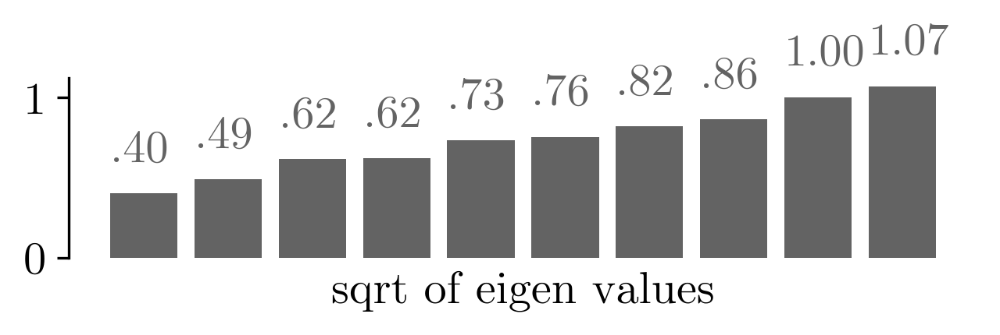

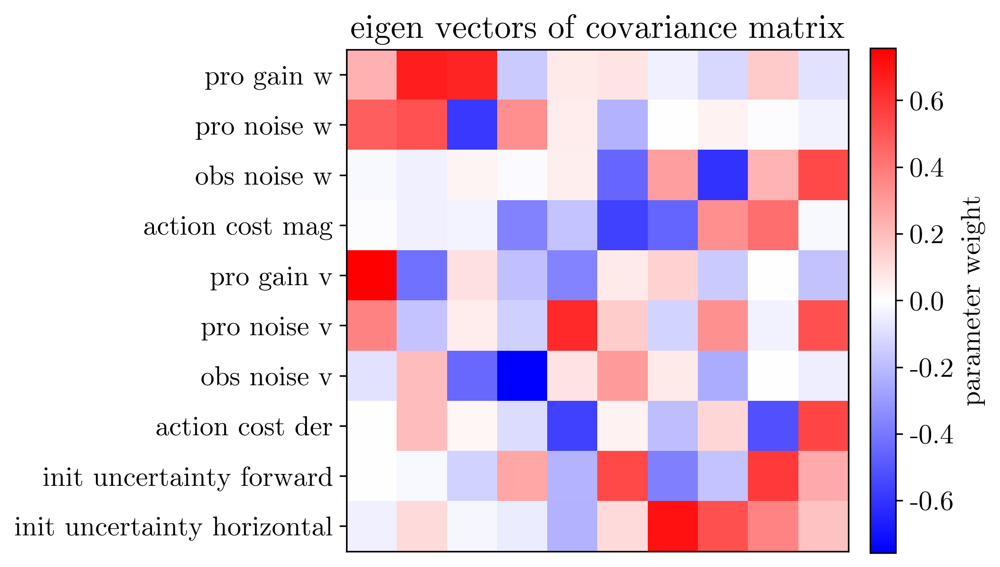

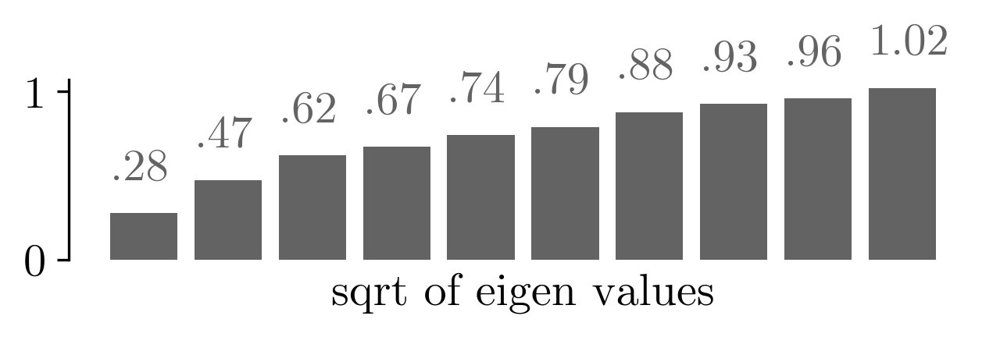

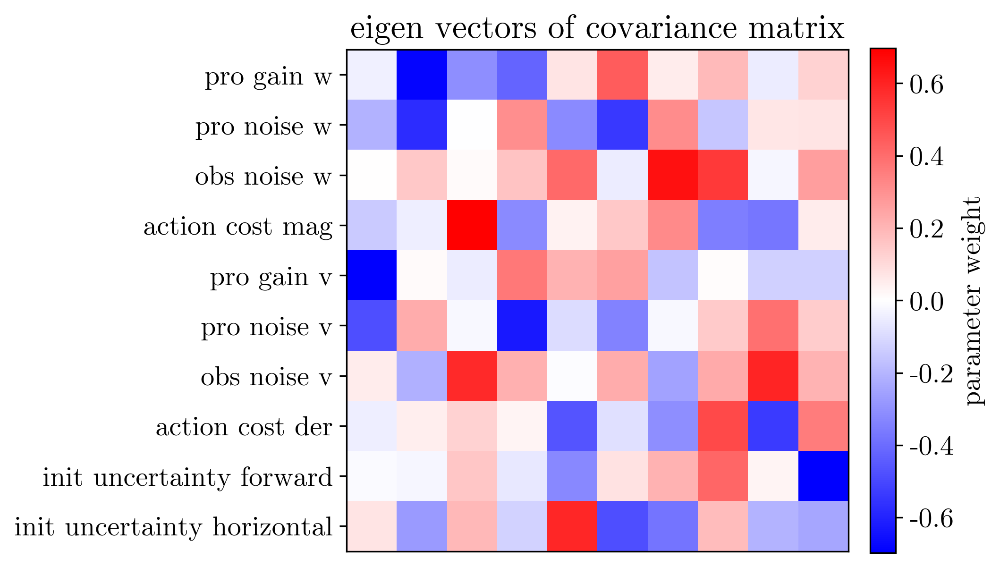

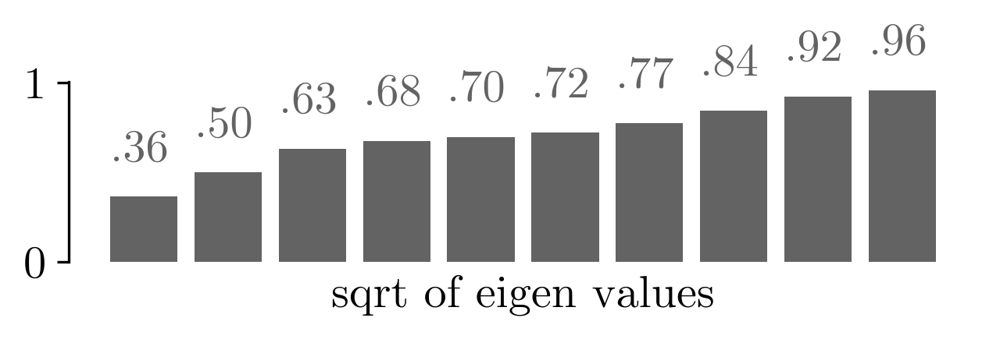

In [66]:
# eig heatmap        
for invtag in ['h','a']:
    for isub in range(numhsub):
        thesub="{}sub{}".format(invtag,str(isub))
        if 'res'+thesub in asd_data_set:
            theta,cov,err=asd_data_set['res'+thesub]
            ev, evector=torch.linalg.eig(torch.tensor(cov))
            ev=ev.real
            evector=evector.real
            ev,esortinds=ev.sort(descending=False)
            evector=evector[:,esortinds]
            inds=[1, 3, 5, 7, 0, 2, 4, 6, 8, 9]
            with initiate_plot(5,5,300) as fig:
                ax=fig.add_subplot(1,1,1)
                img=ax.imshow(evector[inds],cmap=plt.get_cmap('bwr'),
                        vmin=-torch.max(evector),vmax=torch.max(evector),origin='upper')
                c=plt.colorbar(img,fraction=0.046, pad=0.04)
                c.set_label('parameter weight')
                ax.set_title('eigen vectors of covariance matrix')
                x_pos = np.arange(len(theta_names))
                plt.yticks(x_pos, [theta_names[i] for i in inds],ha='right')
                ax.set_xticks([])
                # quicksave('eigvector heatmap??')

            with initiate_plot(5,1,300) as fig:
                ax=fig.add_subplot(1,1,1)
                x_pos = np.arange(len(theta_names))
                # Create bars and choose color
                ax.bar(x_pos, torch.sqrt(ev), color = color_settings['hidden'])
                for i, v in enumerate(torch.sqrt(ev)):
                    number='{0:.2f}'.format(v.item())[1:] if v.item()<1 else '{0:.2f}'.format(v.item())
                    ax.text( i-0.4,v+0.2 , number, color=color_settings['hidden'])
                ax.spines['top'].set_visible(False)
                ax.spines['right'].set_visible(False)
                ax.spines['bottom'].set_visible(False)
                ax.set_xticks([])
                ax.set_xlabel('sqrt of eigen values')
                ax.yaxis.set_minor_formatter(FormatStrFormatter("%.1f"))


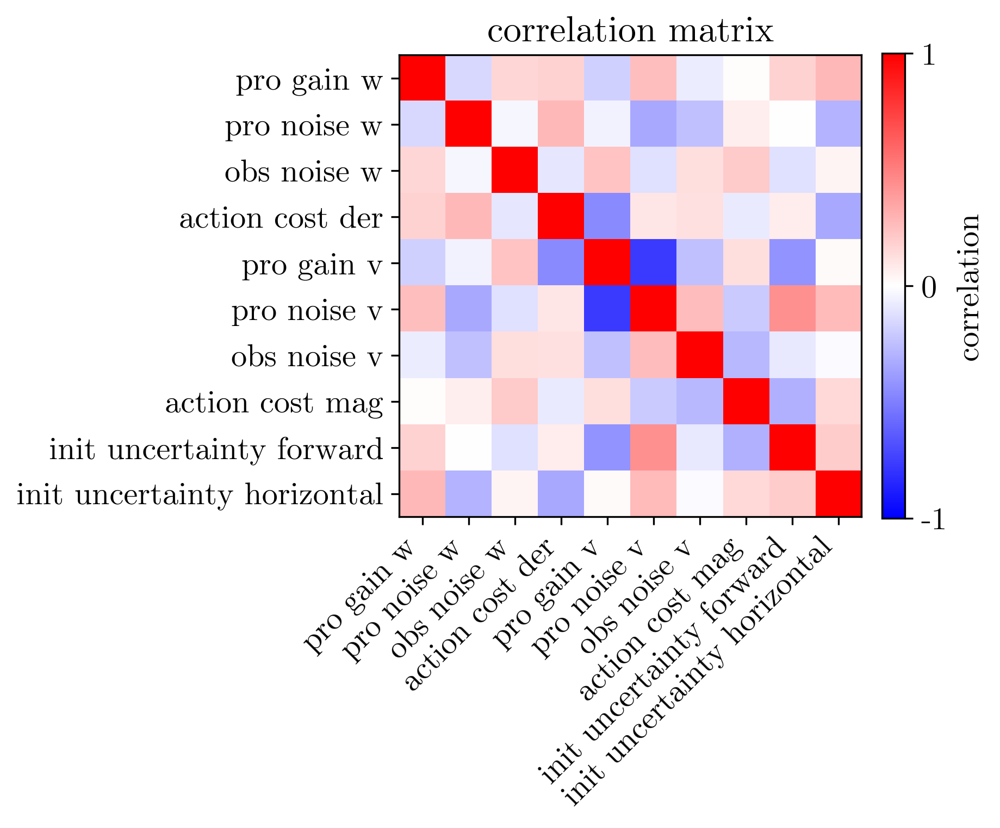

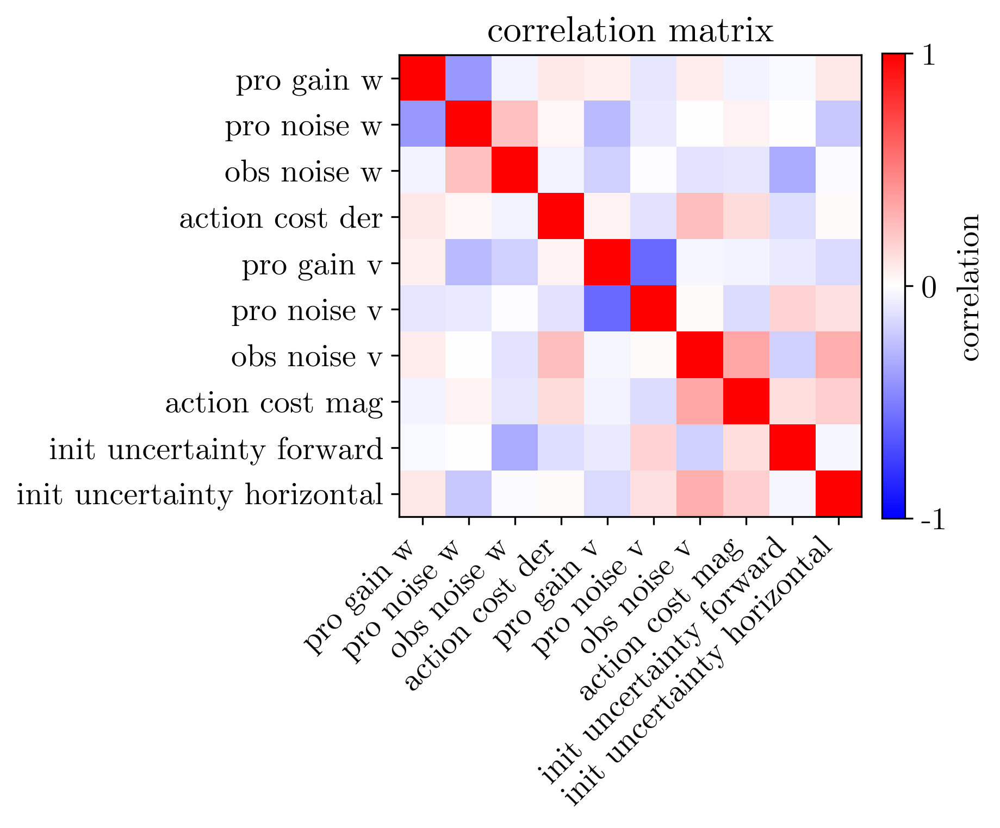

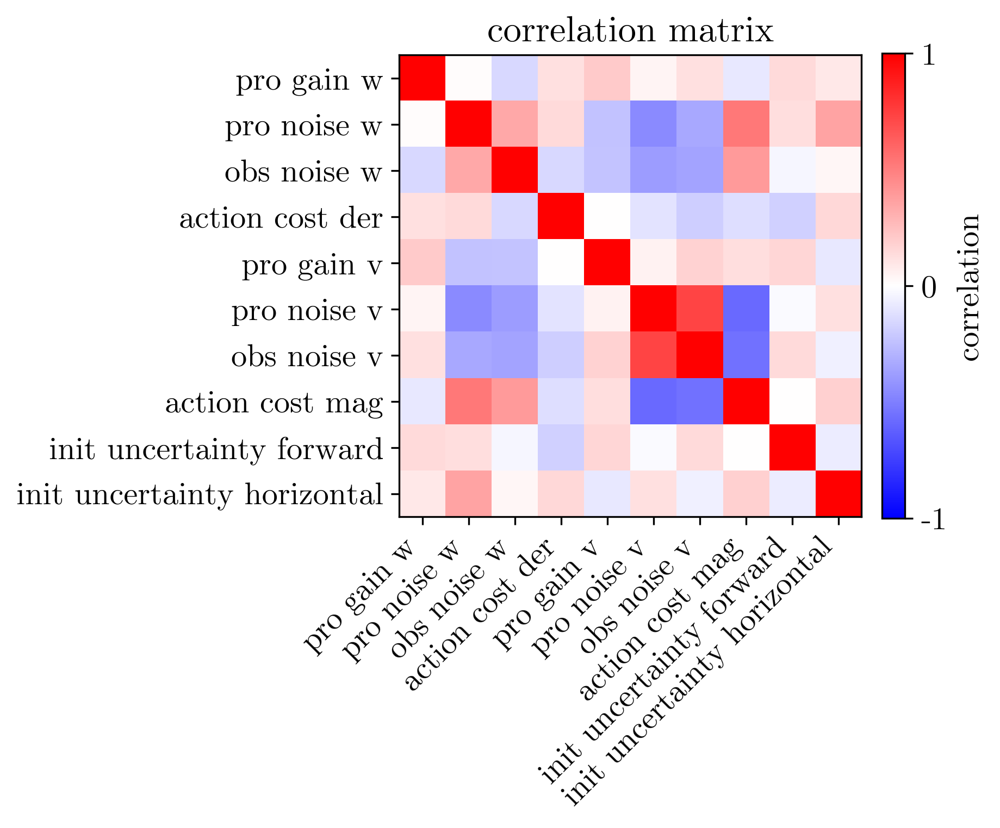

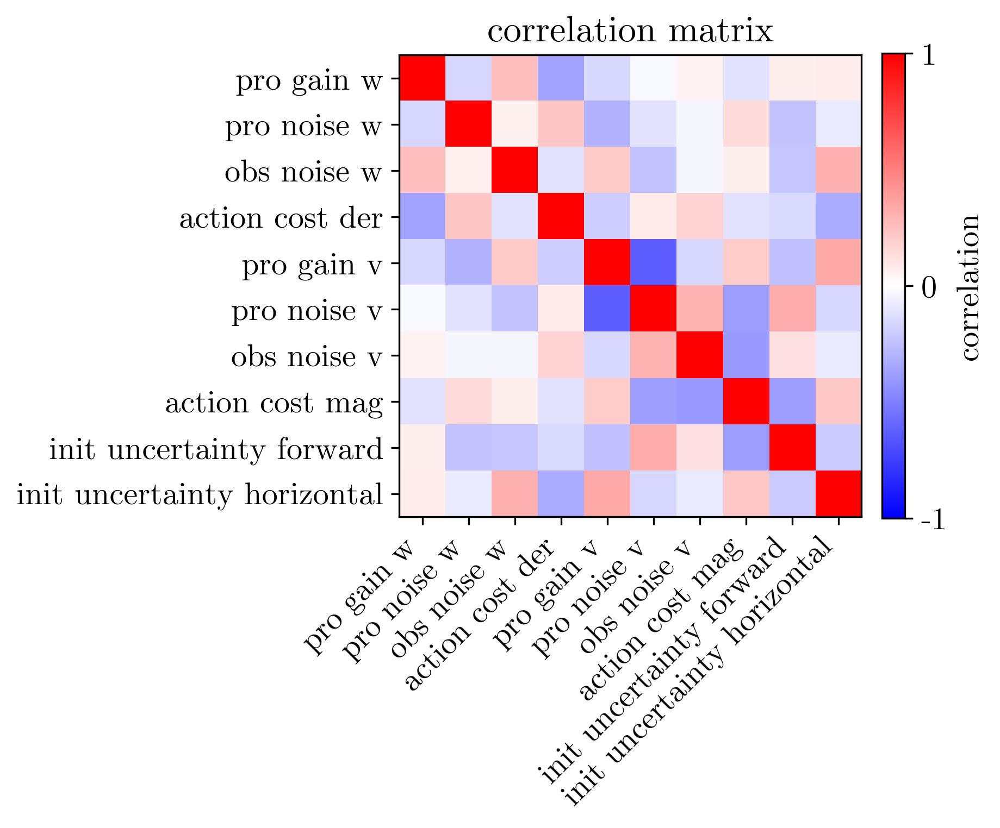

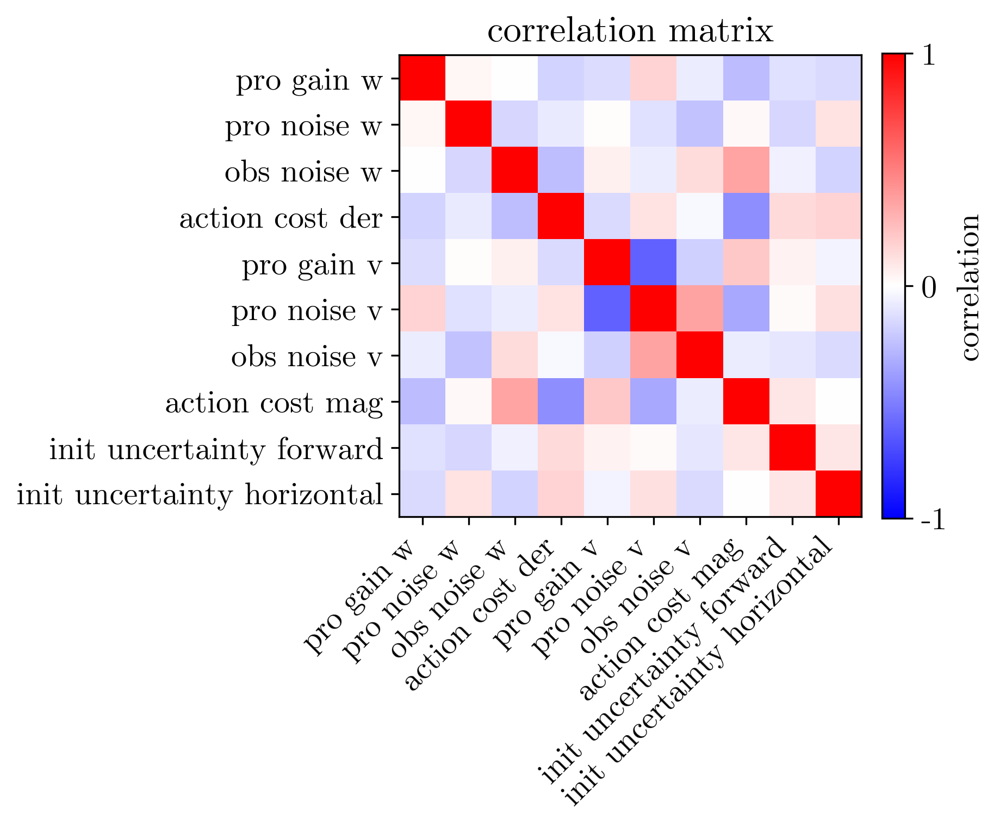

...

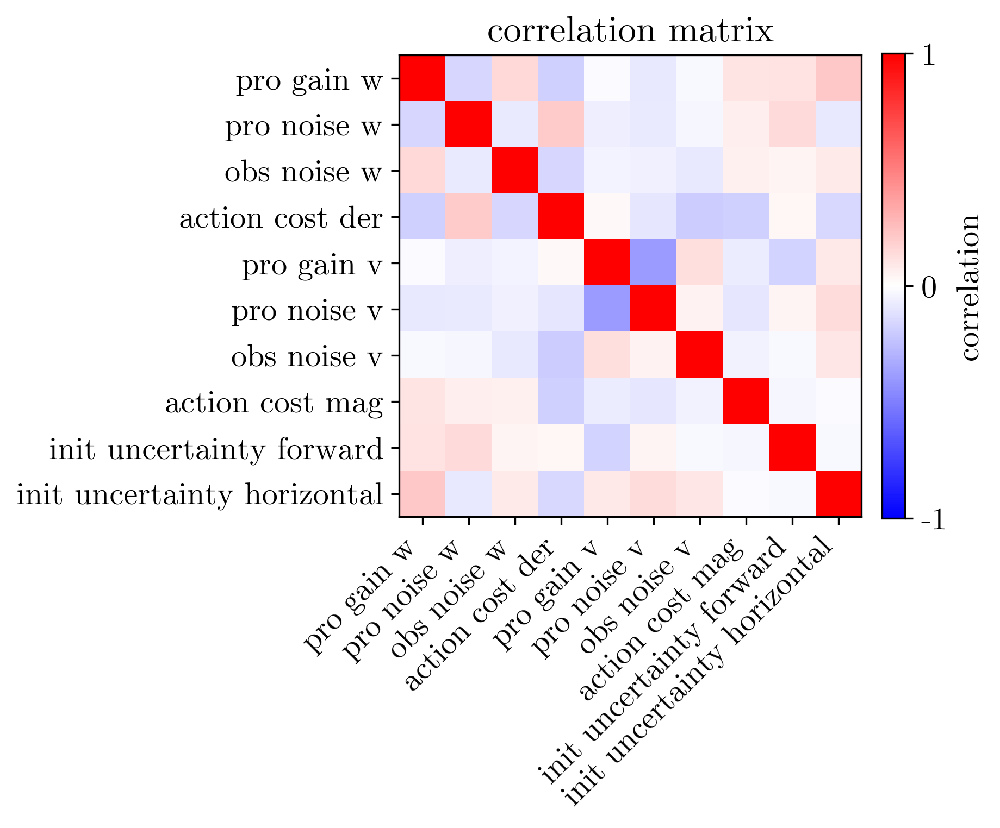

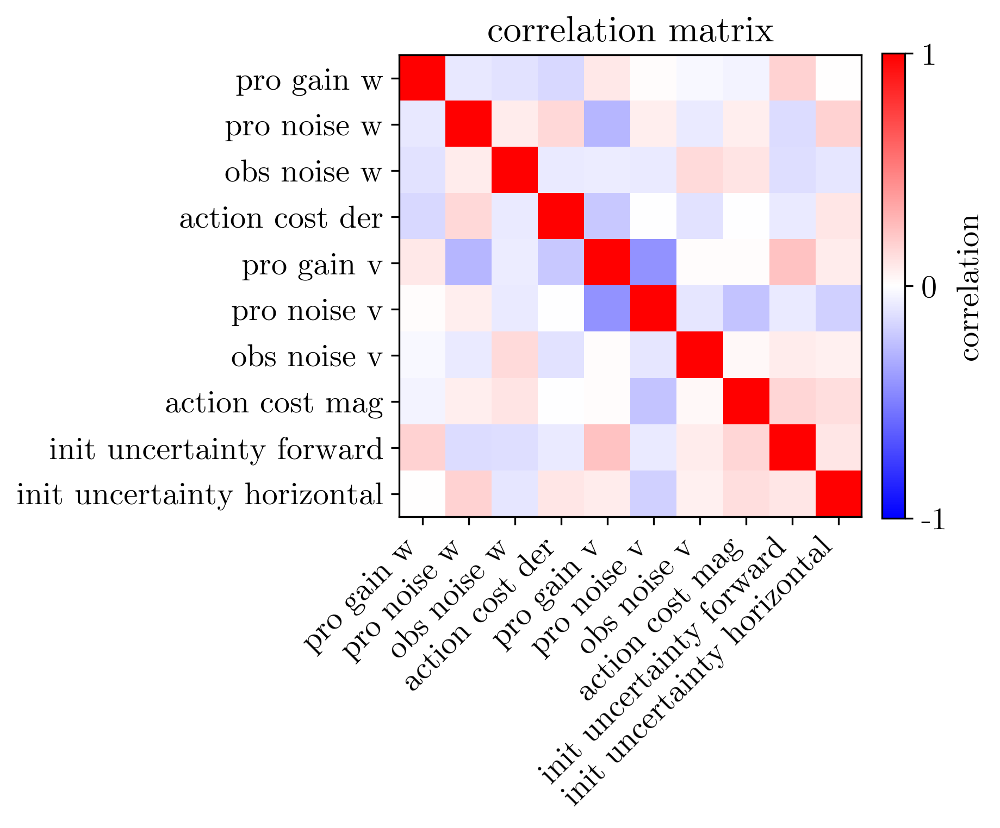

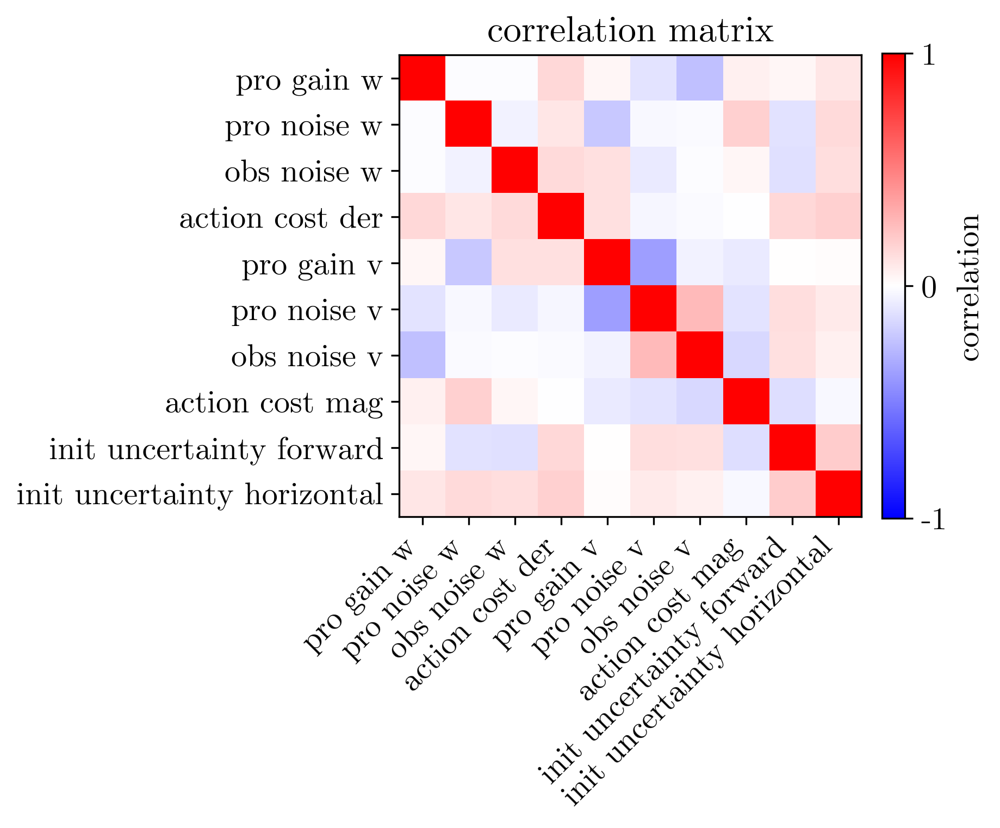

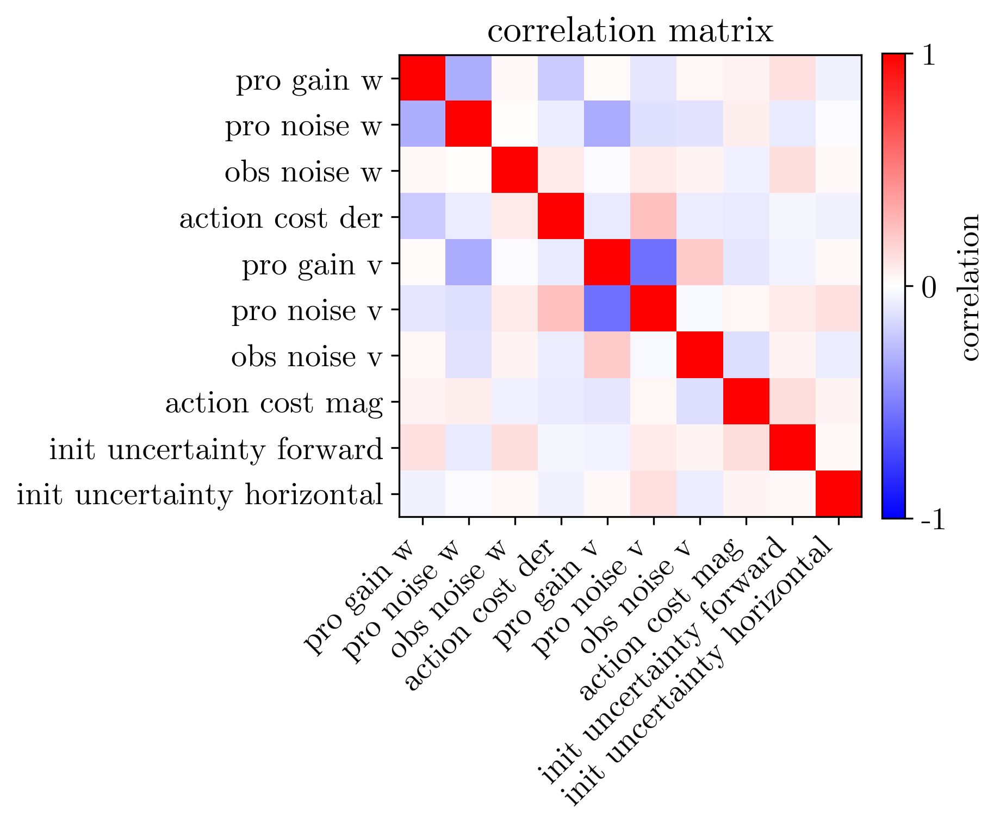

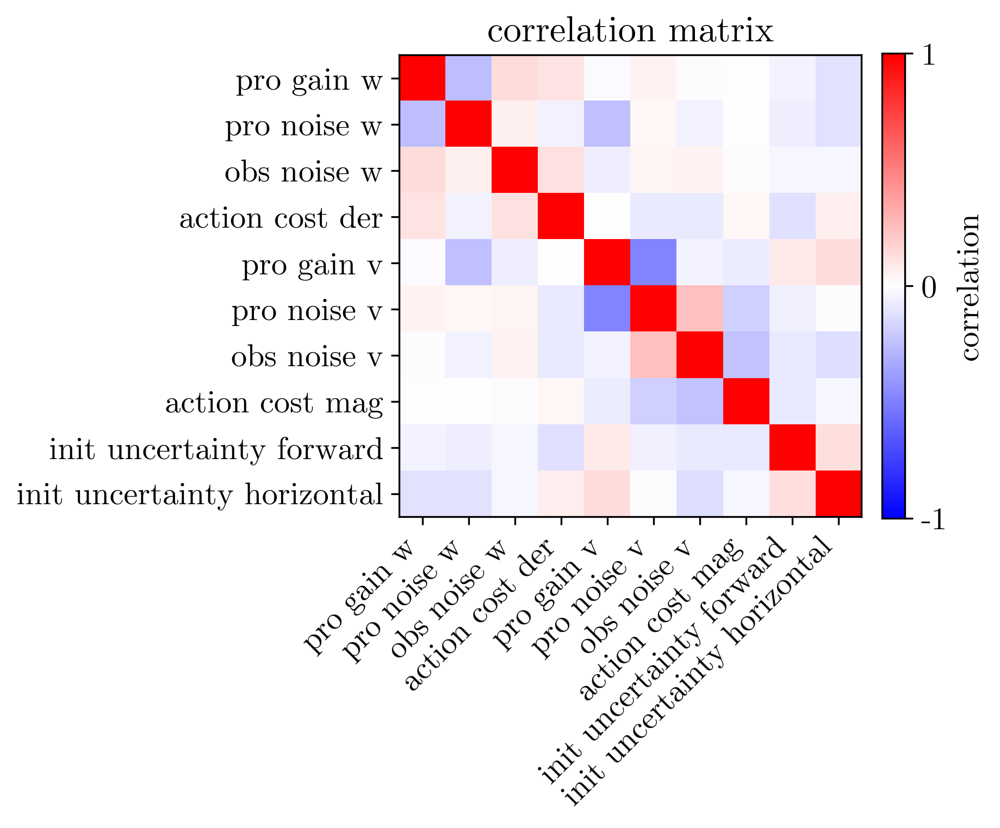

In [67]:
# corr heatmap                
for invtag in ['h','a']:
    for isub in range(numhsub):
        thesub="{}sub{}".format(invtag,str(isub))
        if 'res'+thesub in asd_data_set:
            theta,cov,err=asd_data_set['res'+thesub]
            correlation=correlation_from_covariance(cov)
            inds=[1, 3, 5, 7, 0, 2, 4, 6, 8, 9]
            with initiate_plot(4,4,300) as fig:
                ax=fig.add_subplot(1,1,1)
                im=ax.imshow(correlation[inds].t()[inds].t(),cmap=plt.get_cmap('bwr'),
                    vmin=-torch.max(correlation),vmax=torch.max(correlation))
                ax.set_title('correlation matrix', fontsize=16)
                c=plt.colorbar(im,fraction=0.046, pad=0.04,ticks=[-1, 0, 1])
                c.set_label('correlation')
                x_pos = np.arange(len(theta_names))
                plt.yticks(x_pos, [theta_names[i] for i in inds],ha='right')
                plt.xticks(x_pos, [theta_names[i] for i in inds],rotation=45,ha='right')



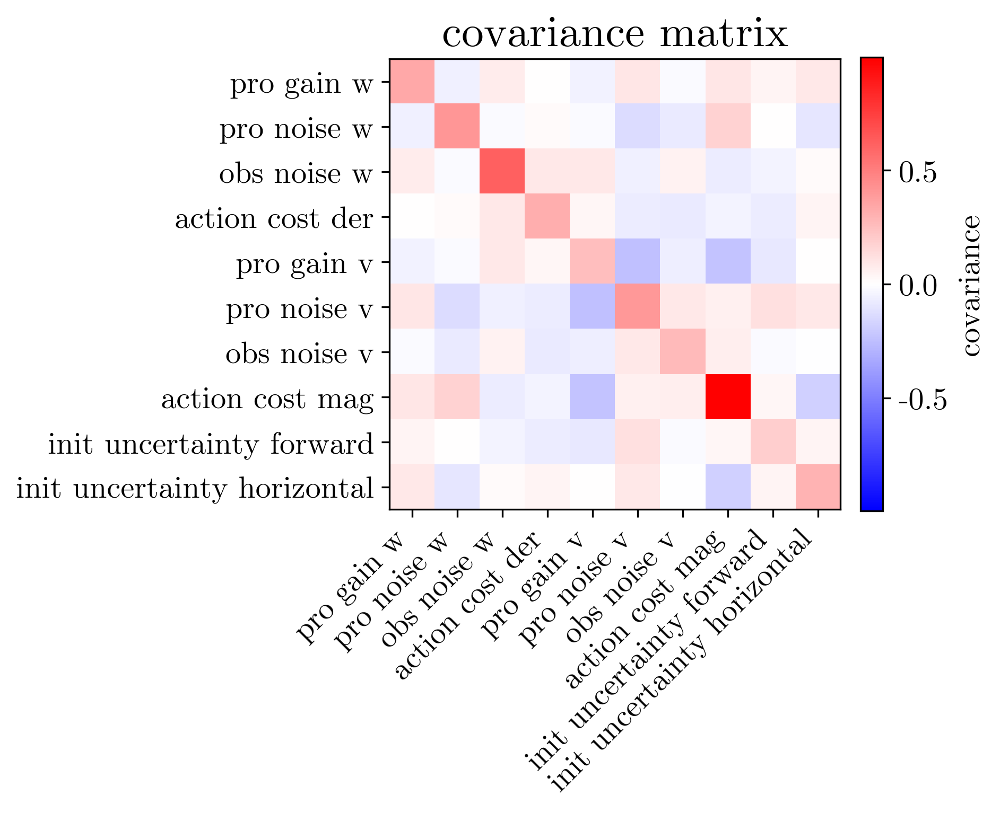

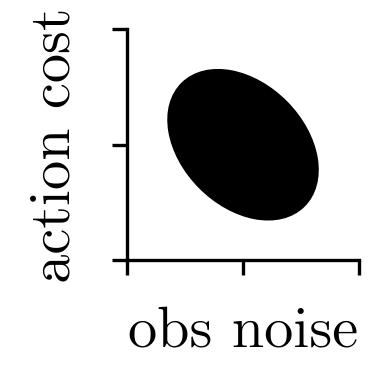

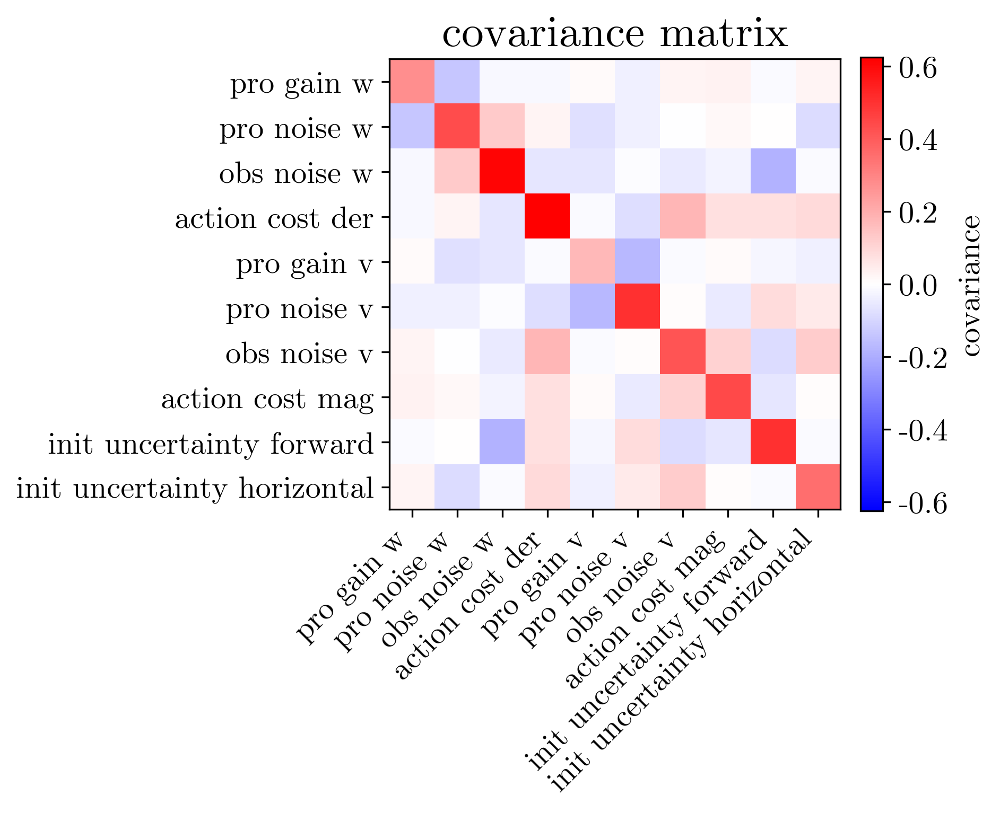

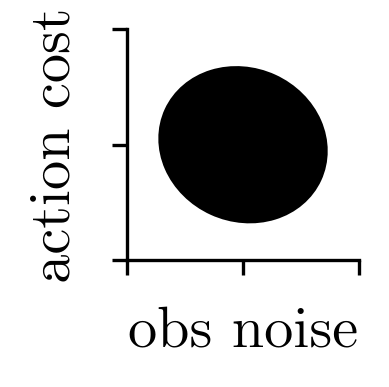

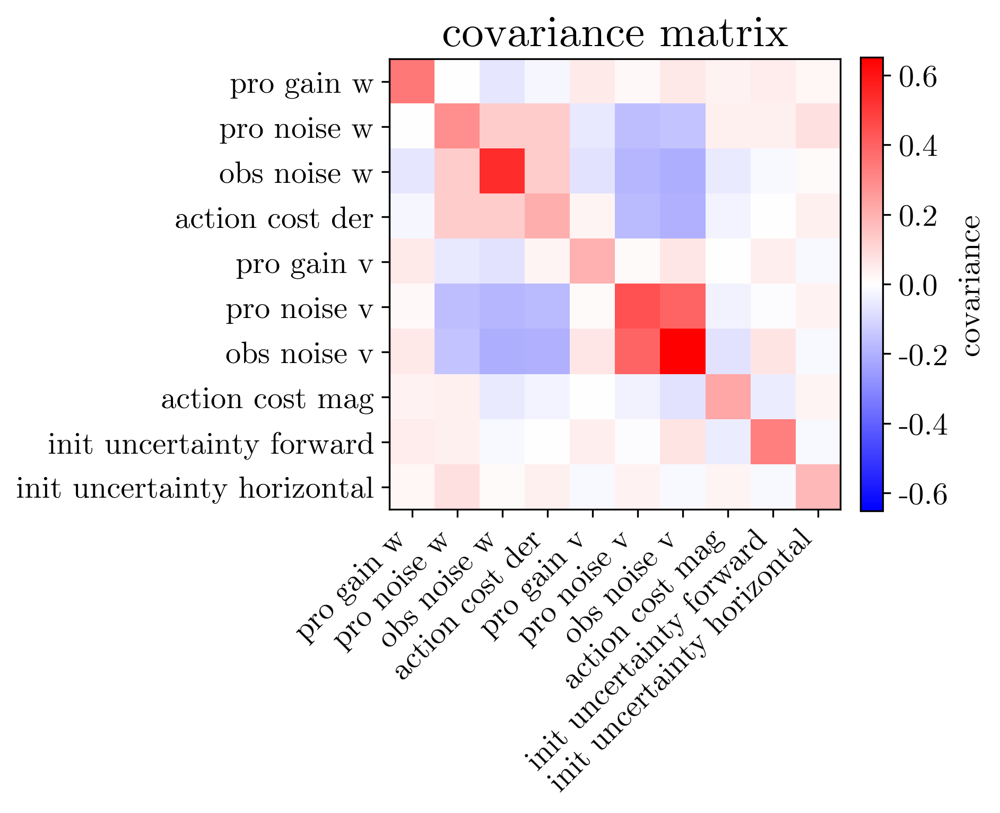

...

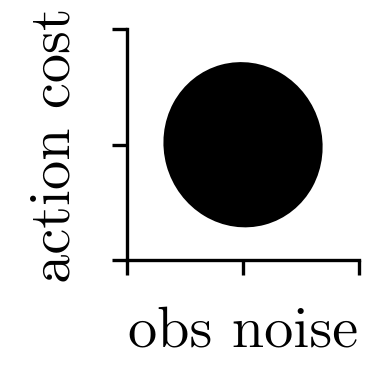

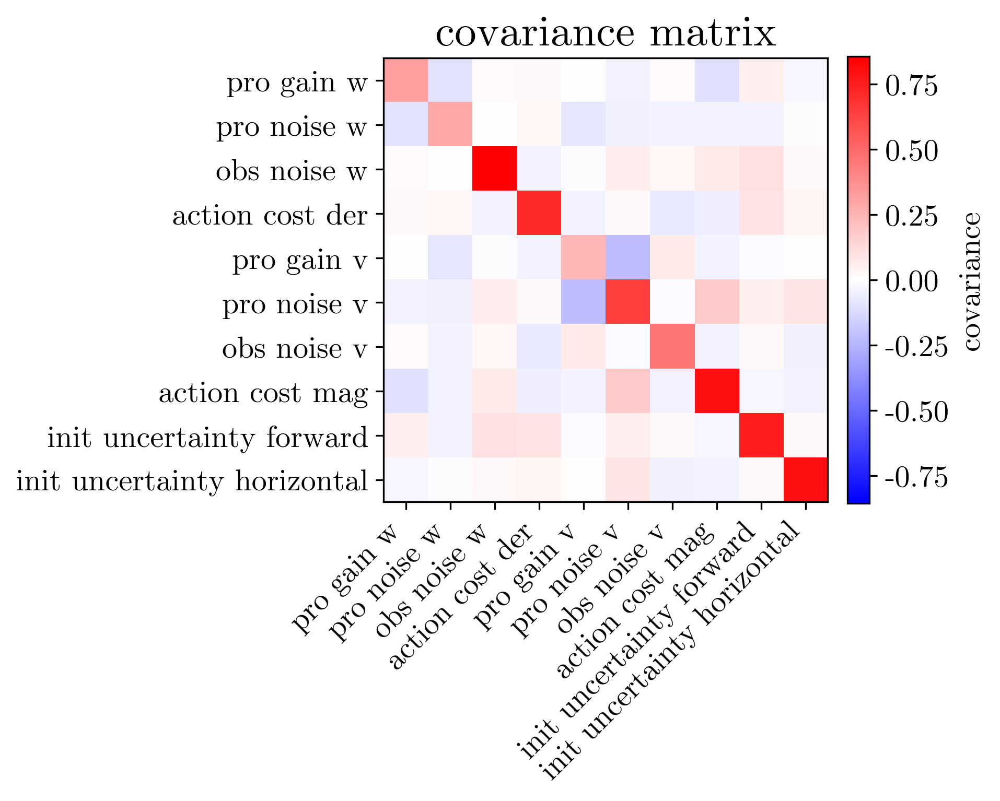

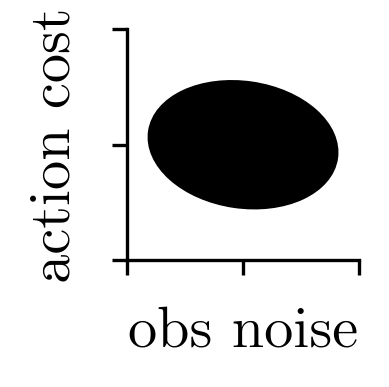

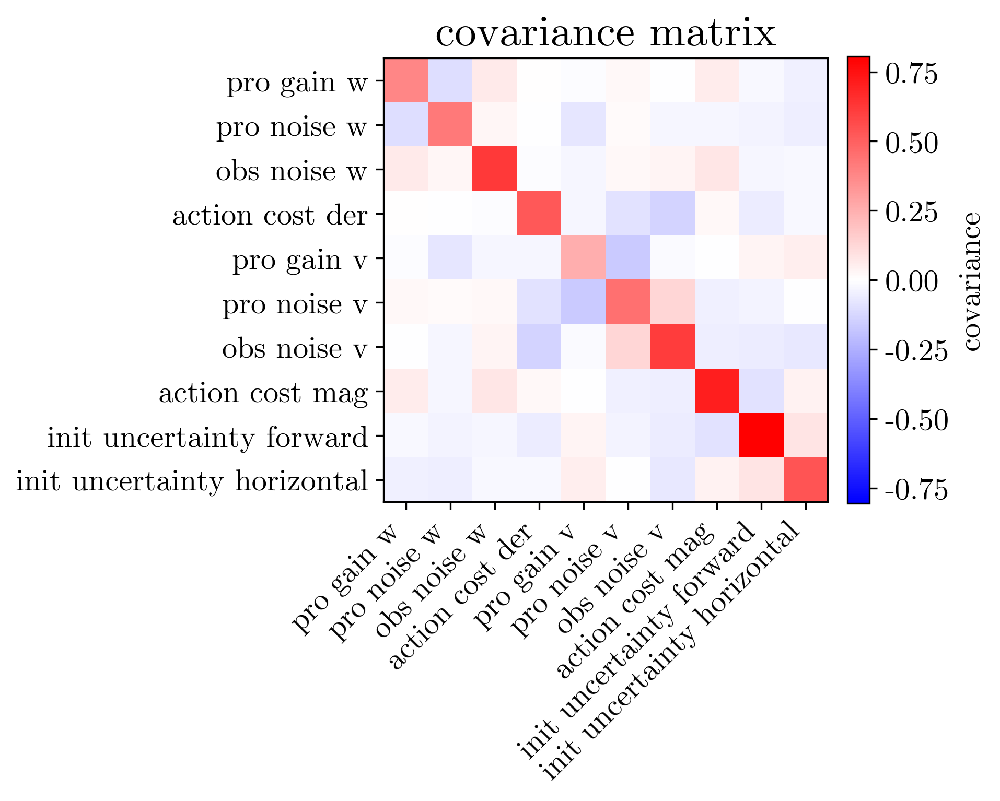

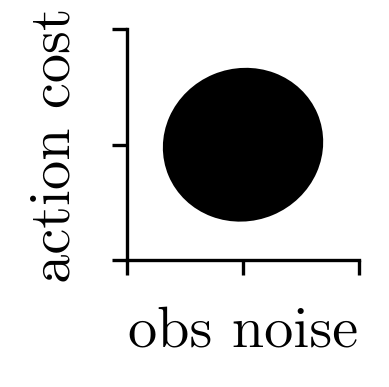

In [27]:

for invtag in ['h','a']:
    for isub in range(numhsub):
        thesub="{}sub{}".format(invtag,str(isub))
        if 'res'+thesub in asd_data_set:
            theta,cov,err=asd_data_set['res'+thesub]
            correlation=correlation_from_covariance(cov)
            inds=[1, 3, 5, 7, 0, 2, 4, 6, 8, 9]
            with initiate_plot(4,4,300) as fig:
                ax=fig.add_subplot(1,1,1)
                cov=torch.tensor(cov)
                im=plt.imshow(cov[inds].t()[inds].t(),cmap=plt.get_cmap('bwr'),vmin=-torch.max(cov),vmax=torch.max(cov))
                ax.set_title('covariance matrix', fontsize=20)
                c=plt.colorbar(im,fraction=0.046, pad=0.04)
                c.set_label('covariance')
                x_pos = np.arange(len(theta_names))
                plt.yticks(x_pos, [theta_names[i] for i in inds],ha='right')
                plt.xticks(x_pos, [theta_names[i] for i in inds],rotation=45,ha='right')
                # quicksave('{} cov'.format(thesub))

            # small ellipse
            with initiate_plot(1,1,300) as fig:
                ax=fig.add_subplot()
                ax.set_xlim(-2,2)
                ax.set_ylim(-2,2)
                ax.set_xticklabels([])
                ax.set_yticklabels([])
                ax.set_xlabel('obs noise') # correslonding to 1,1 in cov
                ax.set_ylabel('action cost') # correslonding to 0,0 in cov
                quickspine(ax)
                plot_cov_ellipse(cov[2:4,2:4],ax=ax, color='black')
                # quicksave('action cost vs noise cov')



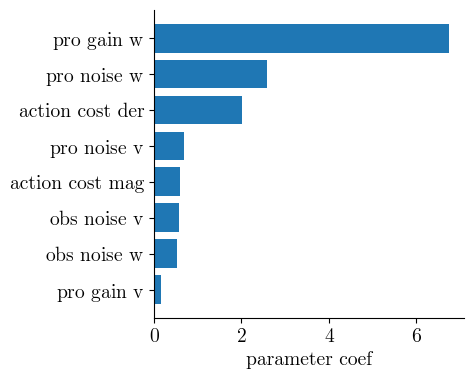


project the individual thetas on to the normal vector.



Text(0, 0.5, 'probability')

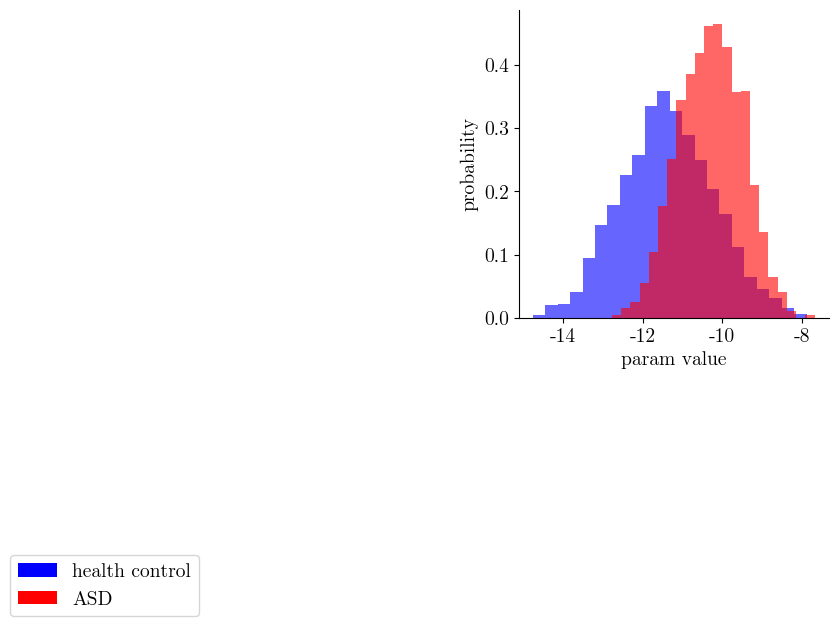

In [68]:
# inferred theta svm --------------------------
# load inv data
numhsub,numasub=25,14
foldername='persub1cont'
logs={'a':datapath/'human/fixragroup','h':datapath/'human/clusterpaperhgroup'}

invres={'a':[],'h':[]}
for isub in range(numhsub):
    dataname="hsub{}".format(str(isub))
    savename=Path(datapath/"human/{}".format(foldername))/"invhsub{}".format(str(isub))
    if savename.is_file():
        invres['h'].append(process_inv(savename,ind=31, usingbest=True))
for isub in range(numasub):
    dataname="asub{}".format(str(isub))
    savename=Path(datapath/"human/{}".format(foldername))/"invasub{}".format(str(isub))
    if savename.is_file():
        invres['a'].append(process_inv(savename,ind=31, usingbest=True))

numsamples=100
adjustratio=len(invres['h'])/len(invres['a'])
alltag=[]
allsamples=[]
for theta,cov,_ in invres['a']:
    distribution=MultivariateNormal(theta.view(-1),cov*0.01)
    samples=[]
    while len(samples)<int(numsamples*adjustratio):
        a=distribution.sample()
        if torch.all(a.clamp(0,2)==a):
            samples.append(a)
    allsamples.append(torch.stack(samples))
    alltag+=[1]*int(numsamples*adjustratio)
for theta,cov,_ in invres['h']:
    distribution=MultivariateNormal(theta.view(-1),cov*0.01)
    samples=[]
    while len(samples)<numsamples:
        a=distribution.sample()
        if torch.all(a.clamp(0,2)==a):
            samples.append(a)
    allsamples.append(torch.stack(samples))
    alltag+=[0]*numsamples

allsamples=np.array(torch.cat(allsamples,axis=0))
alltag=np.array(alltag).astype('int')
X, Y=allsamples,alltag
X = X[np.logical_or(Y==0,Y==1)][:,:8]
Y = Y[np.logical_or(Y==0,Y==1)]
model = svm.SVC(kernel='linear')
clf = model.fit(X, Y)
f_importances(np.abs(clf.coef_[0]),theta_names)
plt.show()

print('''
project the individual thetas on to the normal vector.
''')
w=clf.coef_[0]
ticks=X[:,:8].dot(w)
fig = plt.figure()
ax  = fig.add_subplot(111)
ax.hist(ticks[Y==0],density=True,color='b',bins=22,label='health control',alpha=0.6)
ax.hist(ticks[Y==1],density=True,color='r',bins=22,label='ASD',alpha=0.6)
quickleg(ax)
quickspine(ax)
ax.set_xlabel('param value')
ax.set_ylabel('probability')
# quicksave('asd group project svm normal vector no init uncertainty')


In [29]:

# test
print(stats.ttest_ind(ticks[Y==0],ticks[Y==1]), '\n',
stats.ks_2samp(ticks[Y==0],ticks[Y==1], alternative='two-sided'),'\n',
stats.ks_2samp(ticks[Y==0],ticks[Y==1], alternative='less'),'\n',
stats.ks_2samp(ticks[Y==0],ticks[Y==1], alternative='greater'),'\n',
stats.anderson_ksamp([ticks[Y==0],ticks[Y==1]]),
# stests.weightstats.ztest(ticks[Y==0],ticks[Y==1]),
# scipy.special.kl_div(ticks[Y==0],ticks[Y==1]),
)




TtestResult(statistic=-36.219472536675354, pvalue=6.518721217365232e-253, df=4594.0) 
 KstestResult(statistic=0.44269656112710193, pvalue=3.368310484551962e-203, statistic_location=-9.775577149106129, statistic_sign=1) 
 KstestResult(statistic=0.0034729586426299045, pvalue=0.9692922400702076, statistic_location=-7.190305905578043, statistic_sign=-1) 
 KstestResult(statistic=0.44269656112710193, pvalue=1.651770395869249e-196, statistic_location=-9.775577149106129, statistic_sign=1) 
 Anderson_ksampResult(statistic=703.971537167054, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), pvalue=0.001)


## varaince instead of covariance (remove covariance information)

In [30]:
# var instead of cov
invres={'a':[],'h':[]}
for isub in range(numhsub):
    dataname="hsub{}".format(str(isub))
    savename=Path(datapath/"human/{}".format(foldername))/"invhsub{}".format(str(isub))
    if savename.is_file():
        invres['h'].append(process_inv(savename,ind=31, usingbest=True))
for isub in range(numasub):
    dataname="asub{}".format(str(isub))
    savename=Path(datapath/"human/{}".format(foldername))/"invasub{}".format(str(isub))
    if savename.is_file():
        invres['a'].append(process_inv(savename,ind=31, usingbest=True))


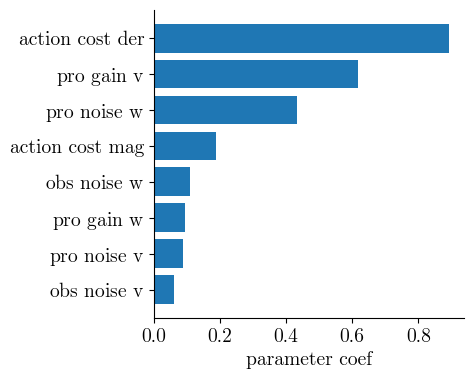


project the individual thetas on to the normal vector.



Text(0, 0.5, 'probability')

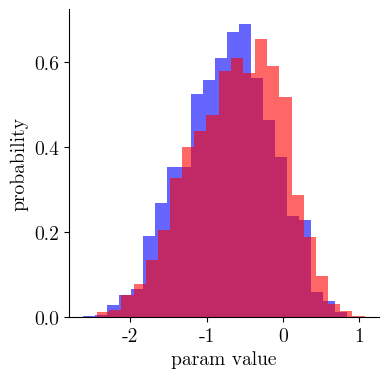

In [69]:

numsamples=100
adjustratio=len(invres['h'])/len(invres['a'])
alltag=[]
allsamples=[]
for theta,cov,_ in invres['a']:
    distribution=MultivariateNormal(theta.view(-1),torch.diag(torch.diag(cov)))
    samples=[]
    while len(samples)<int(numsamples*adjustratio):
        a=distribution.sample()
        if torch.all(a.clamp(0,2)==a):
            samples.append(a)
    allsamples.append(torch.stack(samples))
    alltag+=[1]*int(numsamples*adjustratio)
for theta,cov,_ in invres['h']:
    distribution=MultivariateNormal(theta.view(-1),torch.diag(torch.diag(cov)))
    samples=[]
    while len(samples)<numsamples:
        a=distribution.sample()
        if torch.all(a.clamp(0,2)==a):
            samples.append(a)
    allsamples.append(torch.stack(samples))
    alltag+=[0]*numsamples

allsamples=np.array(torch.cat(allsamples,axis=0))
alltag=np.array(alltag).astype('int')
X, Y=allsamples,alltag
X = X[np.logical_or(Y==0,Y==1)][:,:8]
Y = Y[np.logical_or(Y==0,Y==1)]
model = svm.SVC(kernel='linear')
clf = model.fit(X, Y)
f_importances(np.abs(clf.coef_[0]),theta_names)
plt.show()

print('''
project the individual thetas on to the normal vector.
''')
w=clf.coef_[0]
ticks=X[:,:8].dot(w)
fig = plt.figure()
ax  = fig.add_subplot(111)
ax.hist(ticks[Y==0],density=True,color='b',bins=22,label='health control',alpha=0.6)
ax.hist(ticks[Y==1],density=True,color='r',bins=22,label='ASD',alpha=0.6)
# quickleg(ax)
quickspine(ax)
ax.set_xlabel('param value')
ax.set_ylabel('probability')
# quicksave('asd group project svm normal vector no init uncertainty')

In [32]:

# test
print(stats.ttest_ind(ticks[Y==0],ticks[Y==1]), '\n',
stats.ks_2samp(ticks[Y==0],ticks[Y==1], alternative='two-sided'),'\n',
stats.ks_2samp(ticks[Y==0],ticks[Y==1], alternative='less'),'\n',
stats.ks_2samp(ticks[Y==0],ticks[Y==1], alternative='greater'),'\n',
stats.anderson_ksamp([ticks[Y==0],ticks[Y==1]]),
# stests.weightstats.ztest(ticks[Y==0],ticks[Y==1]),
# scipy.special.kl_div(ticks[Y==0],ticks[Y==1]),
)




TtestResult(statistic=-7.577210410327962, pvalue=4.244167645410288e-14, df=4594.0) 
 KstestResult(statistic=0.0976420239357673, pvalue=5.347991487234977e-10, statistic_location=-0.8556974951345191, statistic_sign=1) 
 KstestResult(statistic=2.272382972276928e-06, pvalue=0.9999977164126405, statistic_location=-2.2181066947818713, statistic_sign=-1) 
 KstestResult(statistic=0.0976420239357673, pvalue=2.7709843817998054e-10, statistic_location=-0.8556974951345191, statistic_sign=1) 
 Anderson_ksampResult(statistic=35.37149356639971, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752, 4.592, 6.546]), pvalue=0.001)


## correlation between cost and observation uncertainty

In [33]:
# load inv data
numhsub,numasub=25,14
foldername='persub1cont'
logs={'a':datapath/'human/fixragroup','h':datapath/'human/clusterpaperhgroup'}

invres={'a':[],'h':[]}
for isub in range(numhsub):
    dataname="hsub{}".format(str(isub))
    savename=Path(datapath/"human/{}".format(foldername))/"invhsub{}".format(str(isub))
    if savename.is_file():
        invres['h'].append(process_inv(savename,ind=31, usingbest=True))
for isub in range(numasub):
    dataname="asub{}".format(str(isub))
    savename=Path(datapath/"human/{}".format(foldername))/"invasub{}".format(str(isub))
    if savename.is_file():
        invres['a'].append(process_inv(savename,ind=31, usingbest=True))



In [34]:

npsummary([subcov[1][5,7] for subcov in invres['h']])
npsummary([subcov[1][5,7] for subcov in invres['a']]+[subcov[1][5,7] for subcov in invres['h']])




n samples  23
mean  -0.016189044
std  0.11465276
sem  0.02390675313958193
med  -0.051843375
range  -0.18410338 0.31746292
n samples  37
mean  -0.009848895
std  0.10066306
sem  0.01654890486984432
med  -0.039399546
range  -0.18410338 0.31746292
